# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
                                    # Note: You need to take the gradient of outputs with respect to inputs.
                                    # This documentation may be useful, but it should not be necessary:
                                    # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
                                    #### START CODE HERE ####
                                    inputs= mixed_images , # input to the model
                                    outputs= mixed_scores , # output of the model
                                    #### END CODE HERE ####
                                    # These other parameters have to do with the pytorch autograd engine works
                                    grad_outputs=torch.ones_like(mixed_scores), 
                                    create_graph=True,
                                    retain_graph=True )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view( len(gradient) , -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm( 2 , dim=1 )
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty =  ( gradient_norm.mean() - 1)**2 
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = (- crit_fake_pred.mean() )
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [12]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + c_lambda*gp
    #### END CODE HERE ####
    return crit_loss

In [13]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.006187493843026459, critic loss: 0.5921984437666835


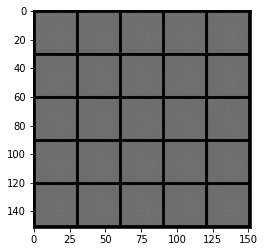

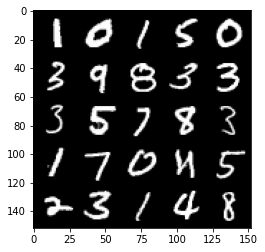

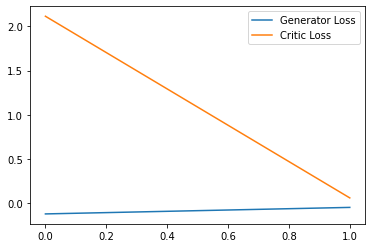

Step 100: Generator loss: 1.6806396138295532, critic loss: -3.5764771822690973


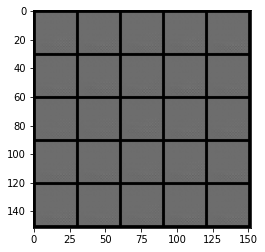

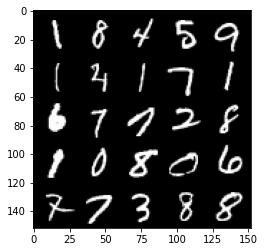

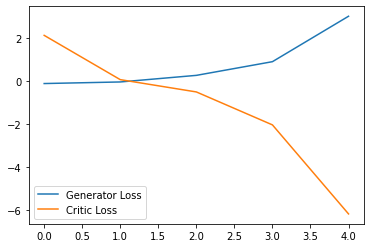

Step 150: Generator loss: 2.892037341594696, critic loss: -15.294323375701902


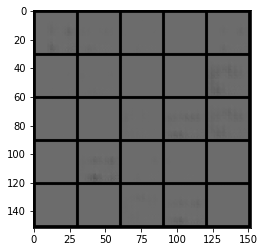

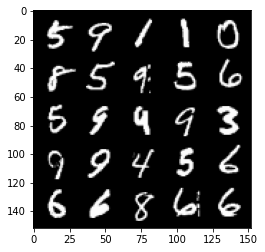

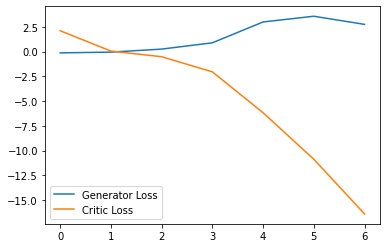

Step 200: Generator loss: 0.7047165320813655, critic loss: -33.28537112426757


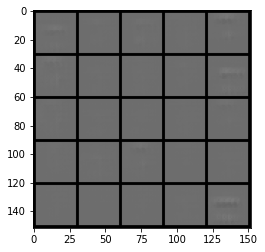

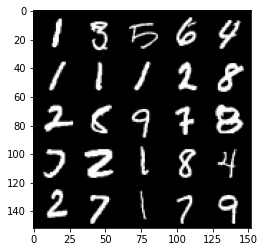

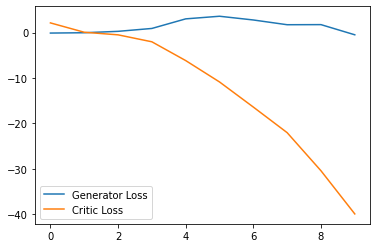

Step 250: Generator loss: -0.8612196895480156, critic loss: -62.35982658386232


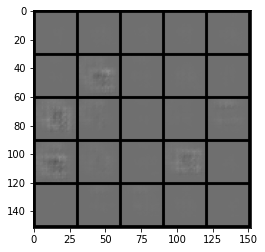

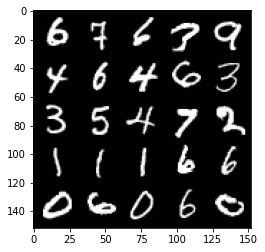

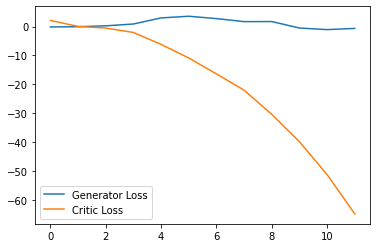

Step 300: Generator loss: -0.8507534241676331, critic loss: -104.17169787597655


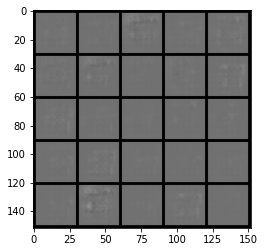

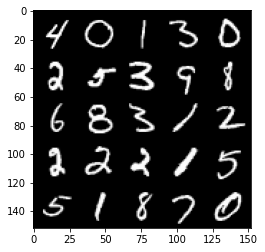

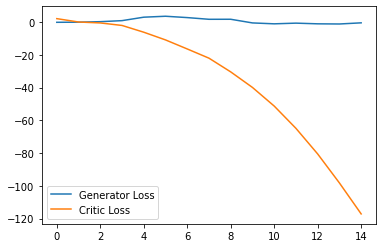

Step 350: Generator loss: -0.6013845819234848, critic loss: -152.97882775878907


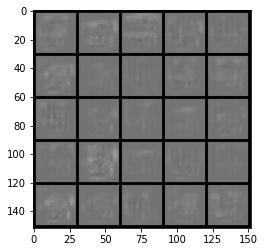

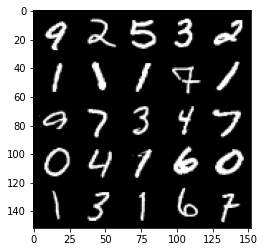

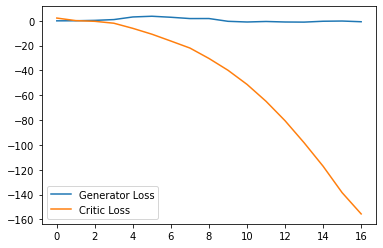

Step 400: Generator loss: 1.6753060039877892, critic loss: -211.05857568359377


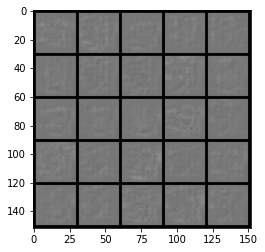

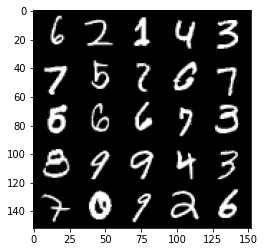

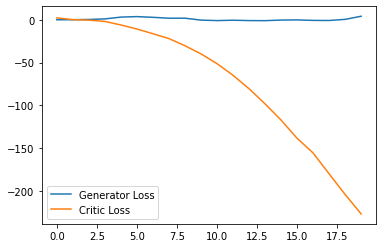

Step 450: Generator loss: 6.237575726509094, critic loss: -270.8095739135743


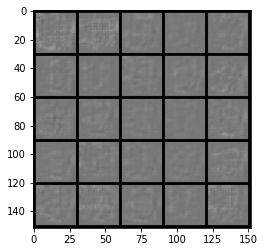

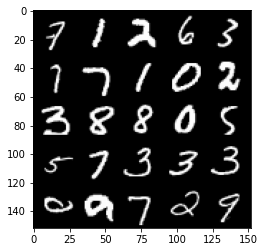

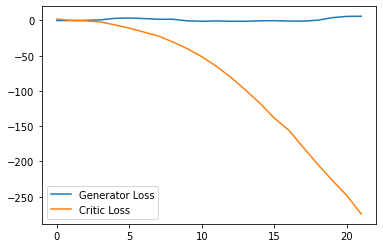

Step 500: Generator loss: -0.7240671610832214, critic loss: -314.5055720825196


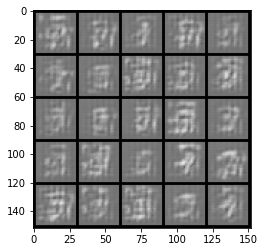

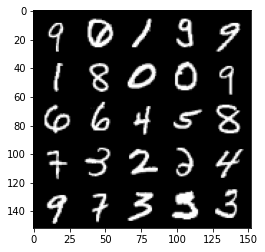

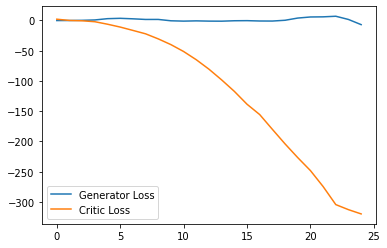

Step 550: Generator loss: -39.20314399242401, critic loss: -268.619354309082


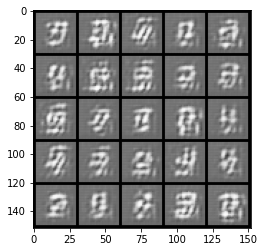

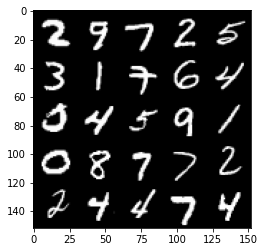

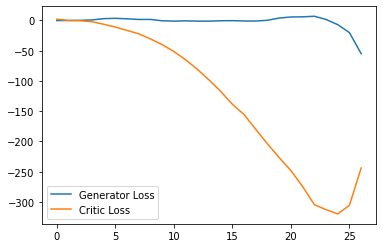

Step 600: Generator loss: 14.292536344528198, critic loss: -344.6502008361816


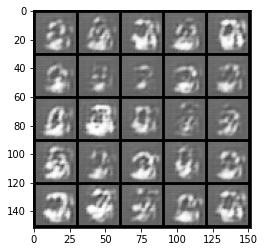

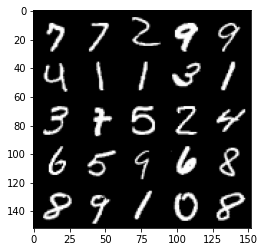

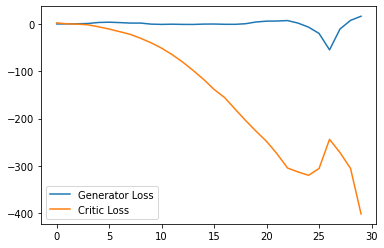

Step 650: Generator loss: -10.823121792972088, critic loss: -394.5551036071777


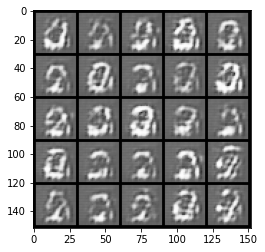

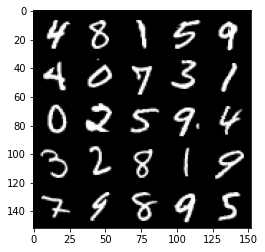

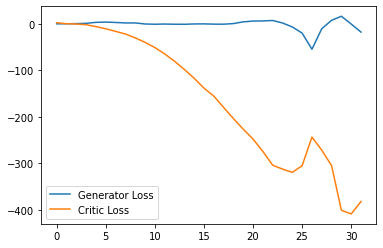

Step 700: Generator loss: -46.22720460891723, critic loss: -350.3467710571289


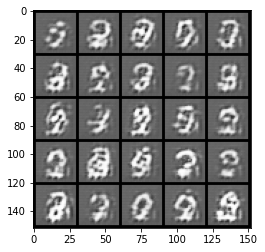

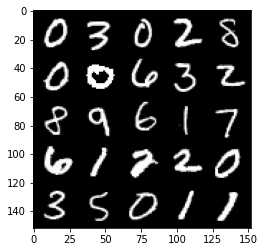

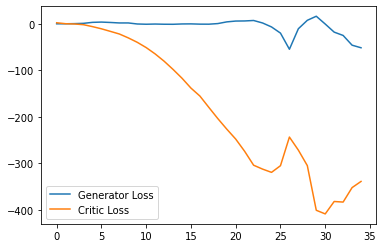

Step 750: Generator loss: -55.56359174251556, critic loss: -311.8216380310059


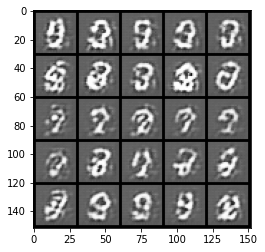

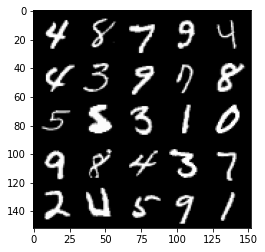

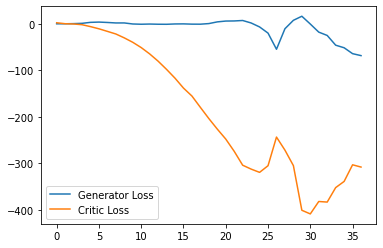

Step 800: Generator loss: -29.566612787246704, critic loss: -330.42761129760737


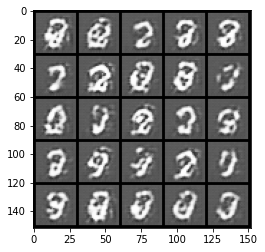

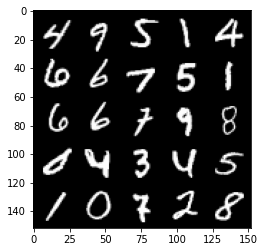

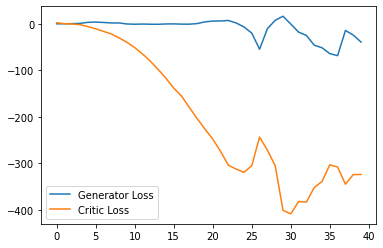

Step 850: Generator loss: -31.127554061412813, critic loss: -342.39331665039055


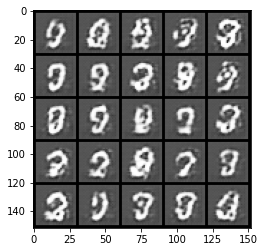

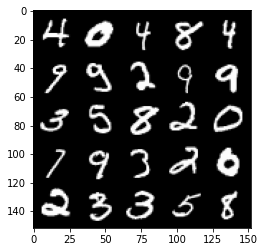

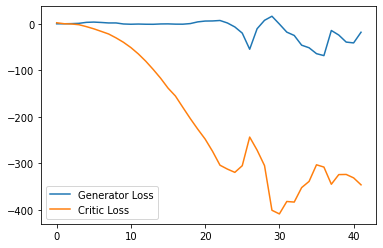

Step 900: Generator loss: -35.064810829162596, critic loss: -72.04934397888186


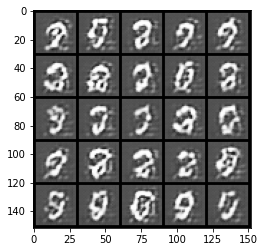

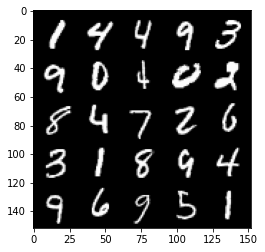

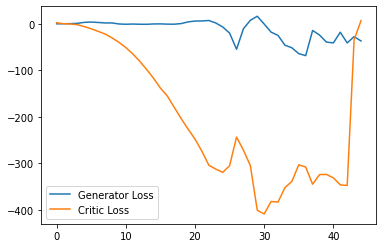

Step 950: Generator loss: -69.49243133544923, critic loss: -68.5290662765503


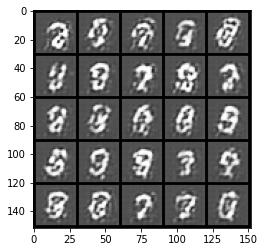

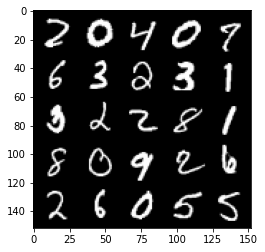

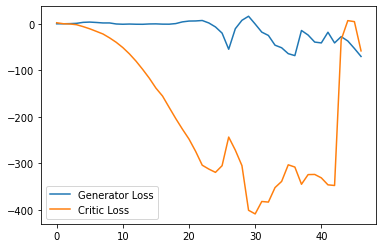

Step 1000: Generator loss: -111.50905441284179, critic loss: -227.06573774719246


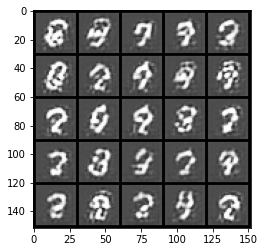

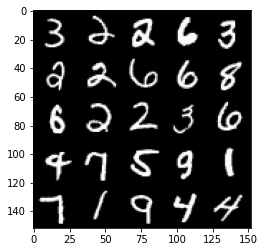

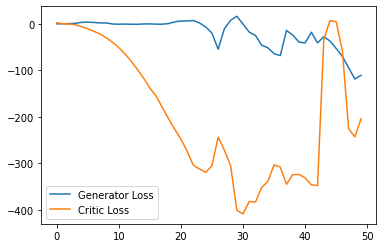

Step 1050: Generator loss: -101.22045488357544, critic loss: -233.6616285552979


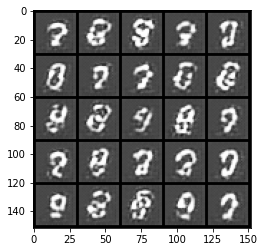

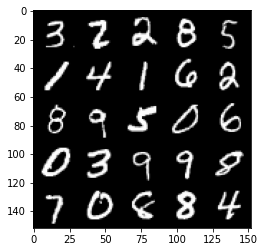

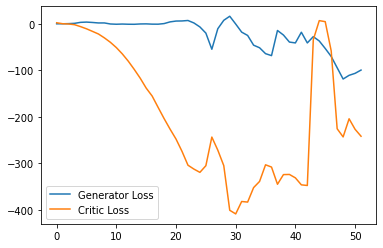

Step 1100: Generator loss: -77.79356038093567, critic loss: -192.70178620910644


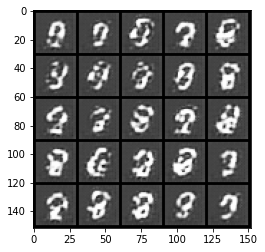

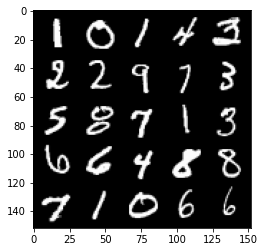

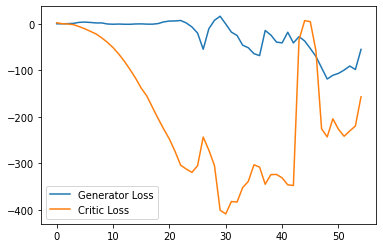

Step 1150: Generator loss: -81.66026504516601, critic loss: -207.69742590332035


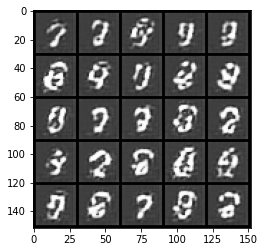

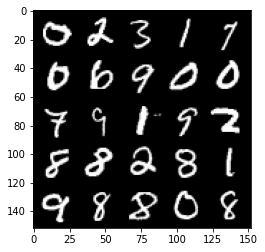

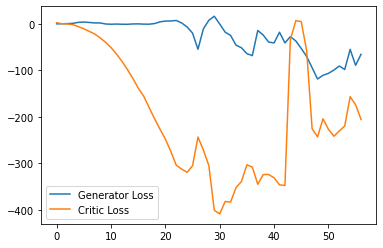

Step 1200: Generator loss: -102.73996417999268, critic loss: -176.70069787597654


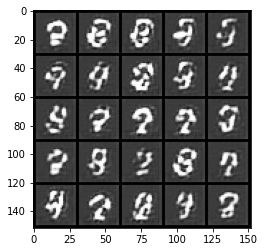

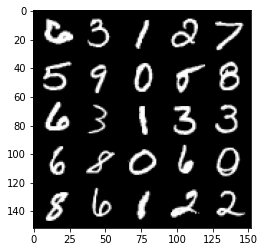

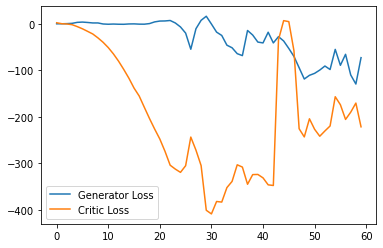

Step 1250: Generator loss: -107.61611392974854, critic loss: -188.5905607910156


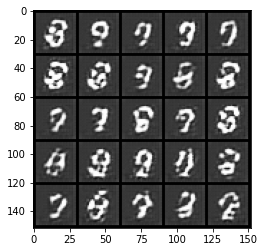

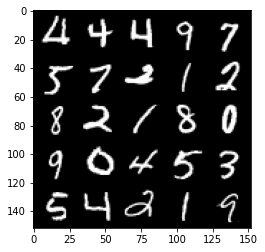

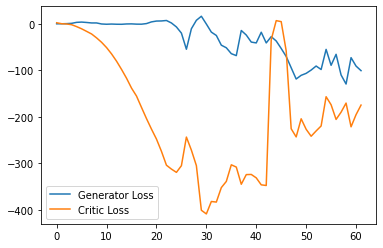

Step 1300: Generator loss: -89.95556997299194, critic loss: -142.31719857788087


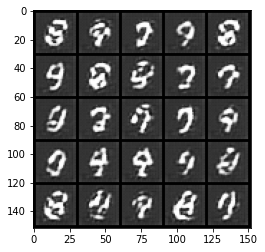

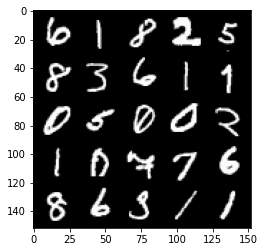

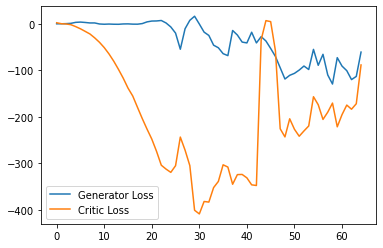

Step 1350: Generator loss: -46.19939855098724, critic loss: 37.44571931076051


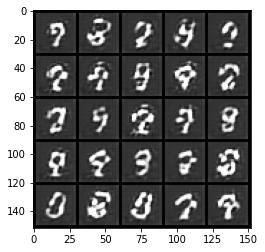

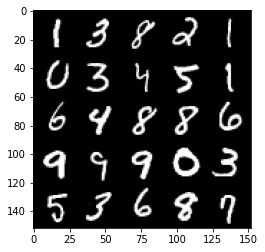

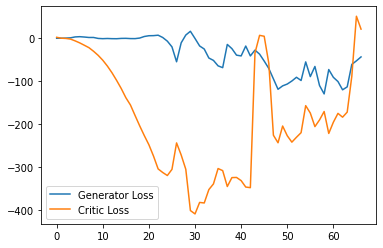

Step 1400: Generator loss: -41.7327734375, critic loss: 11.006661636352543


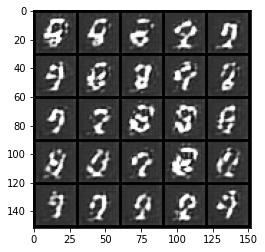

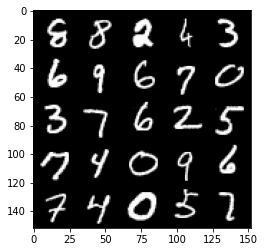

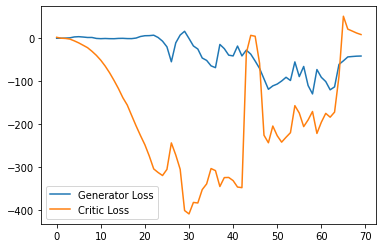

Step 1450: Generator loss: -41.86055511474609, critic loss: 5.186835229873658


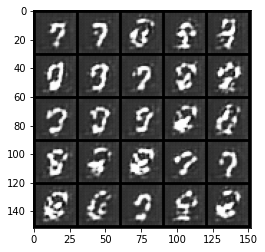

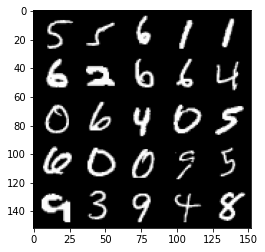

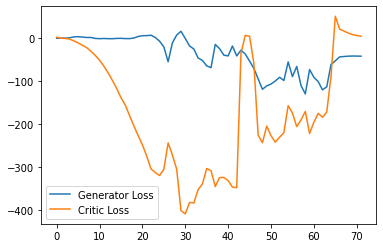

Step 1500: Generator loss: -43.03459434509277, critic loss: 6.107070350646973


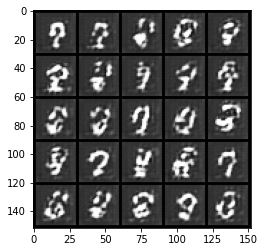

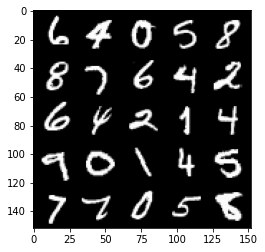

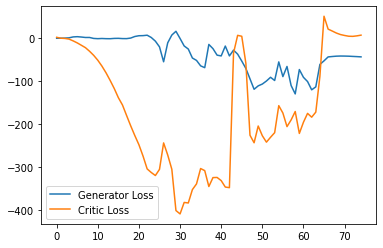

Step 1550: Generator loss: -45.21630928039551, critic loss: 9.204018669128418


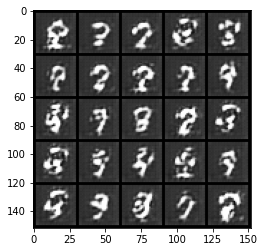

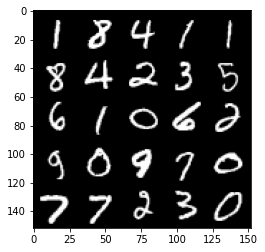

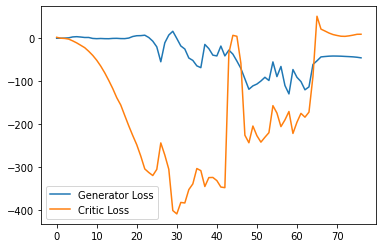

Step 1600: Generator loss: -46.22966896057129, critic loss: 6.607351978301999


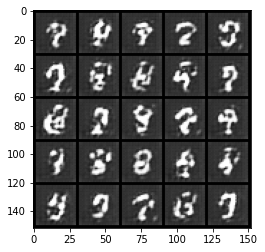

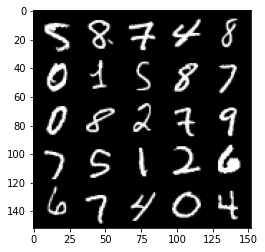

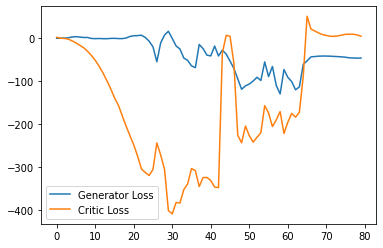

Step 1650: Generator loss: -44.80833831787109, critic loss: 1.2205809535980225


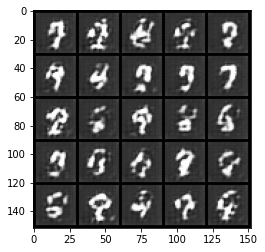

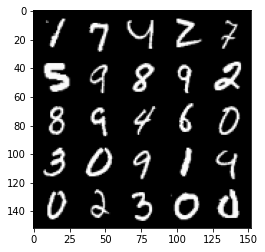

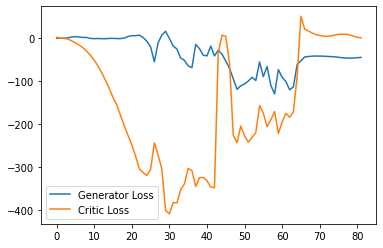

Step 1700: Generator loss: -42.87459609985351, critic loss: -0.5362807846069336


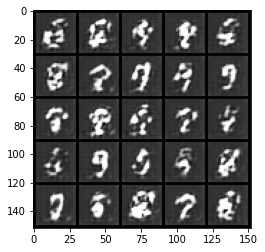

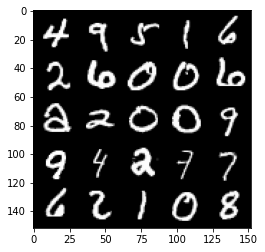

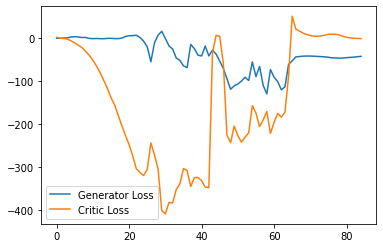

Step 1750: Generator loss: -41.471332473754885, critic loss: -0.31870080757141117


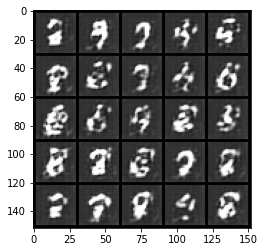

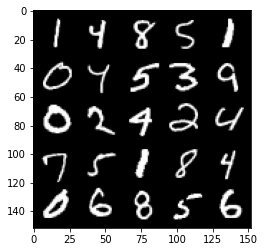

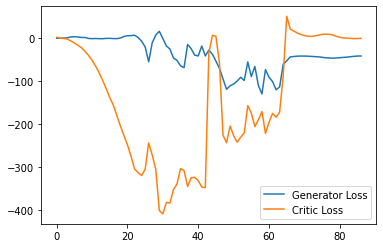

Step 1800: Generator loss: -41.77500129699707, critic loss: 2.501292613983155


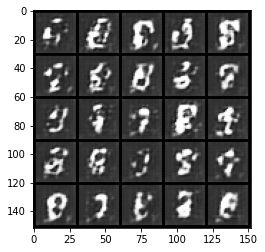

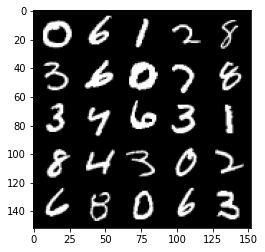

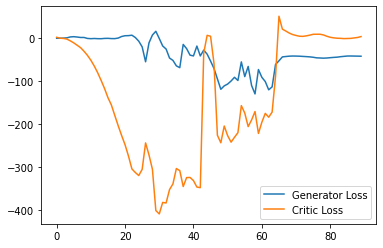

Step 1850: Generator loss: -44.151240844726566, critic loss: 3.654648210525514


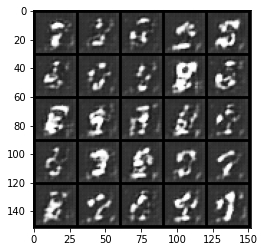

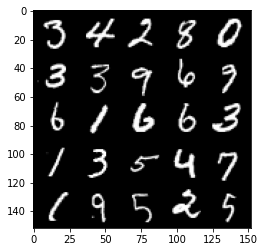

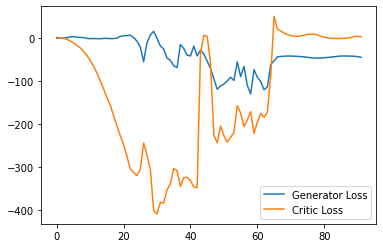

Step 1900: Generator loss: -47.564538192749026, critic loss: 1.913090026855469


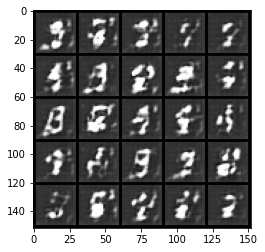

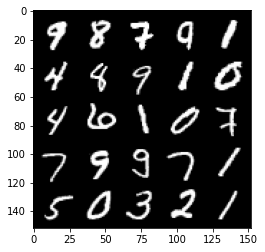

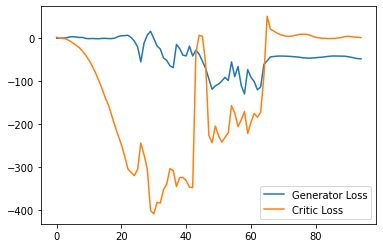

Step 1950: Generator loss: -48.176969604492186, critic loss: 0.8009332447052003


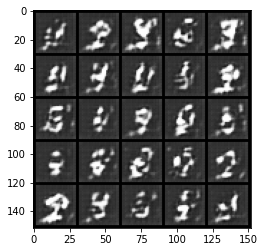

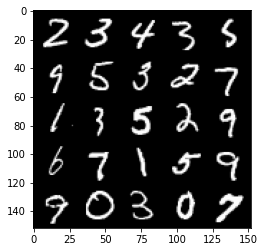

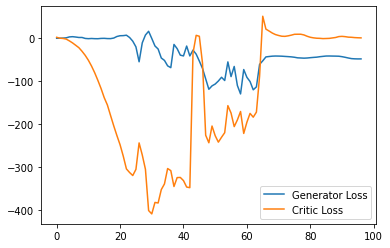

Step 2000: Generator loss: -47.72381858825683, critic loss: -0.2782368183135986


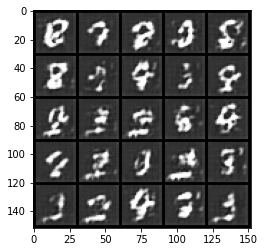

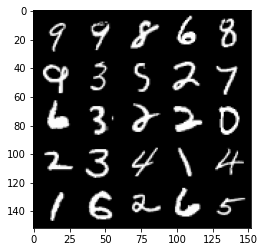

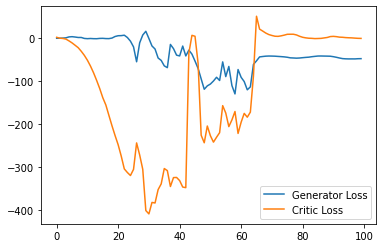

Step 2050: Generator loss: -49.634801635742186, critic loss: -1.5952834501266477


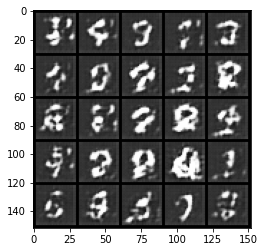

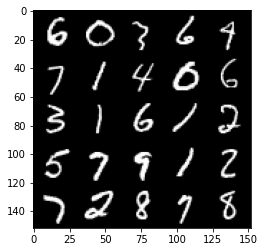

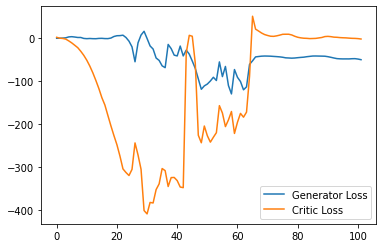

Step 2100: Generator loss: -51.466857986450194, critic loss: -3.3845932950973503


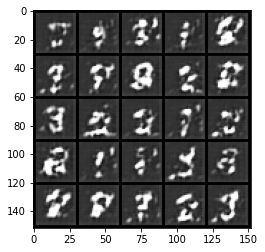

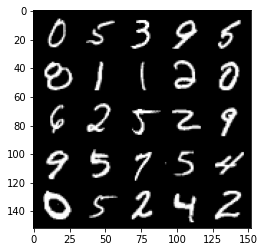

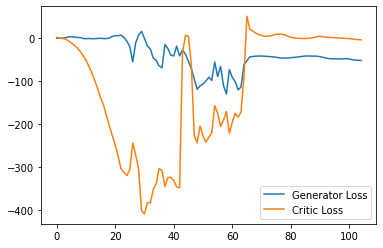

Step 2150: Generator loss: -51.75987823486328, critic loss: -5.699154614448548


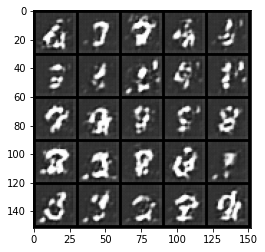

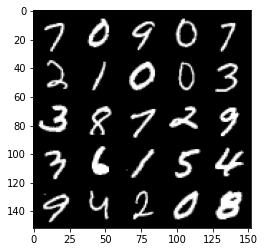

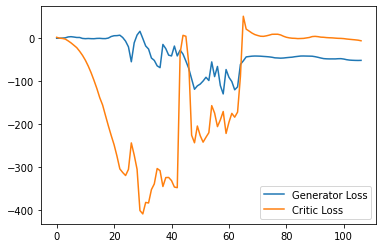

Step 2200: Generator loss: -51.142871398925784, critic loss: -11.235825153350829


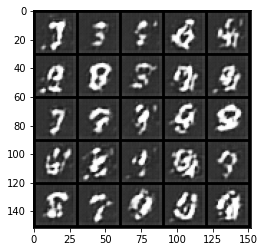

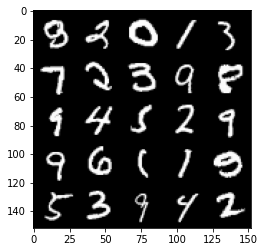

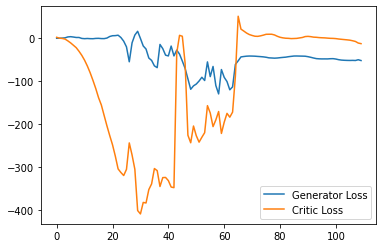

Step 2250: Generator loss: -49.472219924926755, critic loss: -13.769634590148925


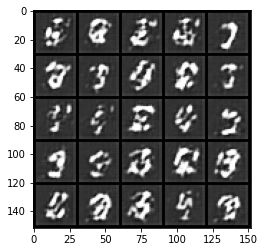

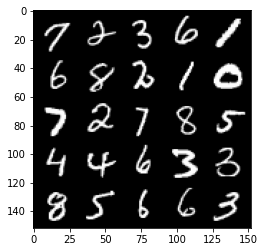

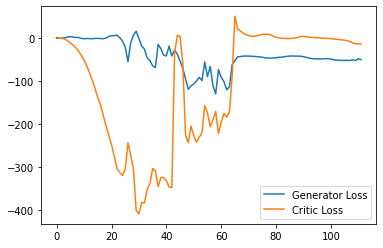

Step 2300: Generator loss: -50.679846954345706, critic loss: -16.329905761718752


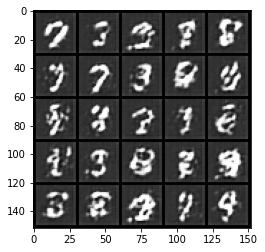

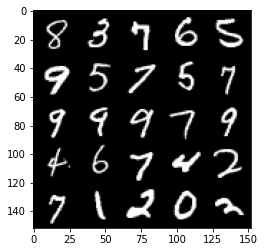

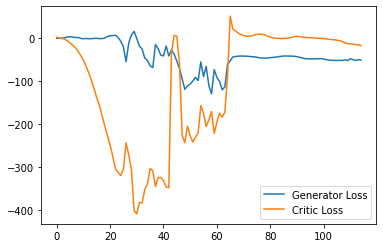

Step 2350: Generator loss: -48.3756697845459, critic loss: -20.252968246459957


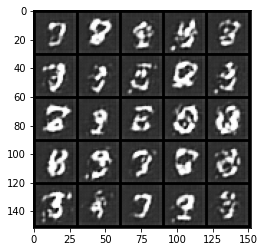

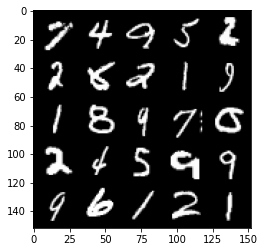

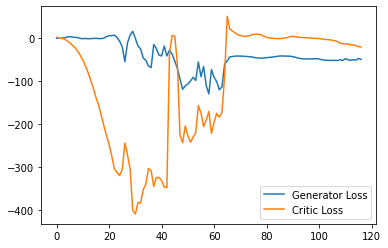

Step 2400: Generator loss: -47.73015941619873, critic loss: -24.34390839767455


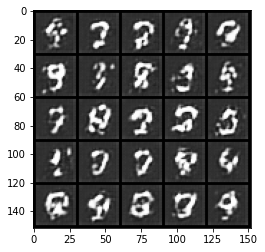

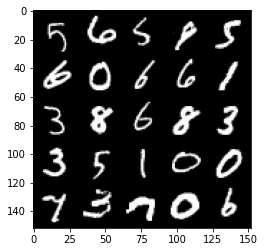

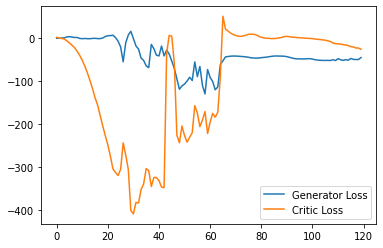

Step 2450: Generator loss: -47.631611557006835, critic loss: -27.66472559738159


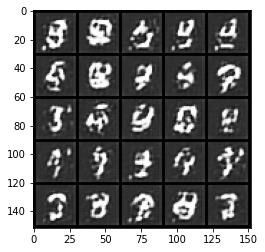

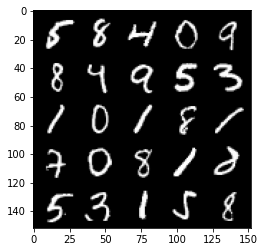

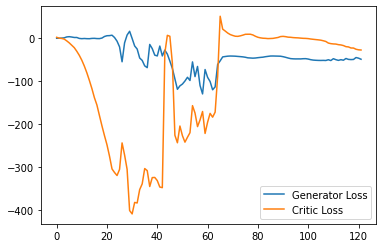

Step 2500: Generator loss: -41.745882453918455, critic loss: -31.30359476089477


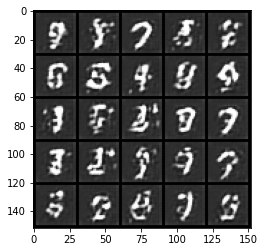

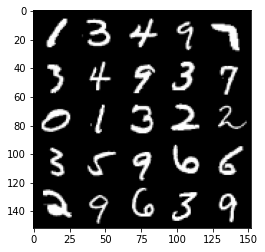

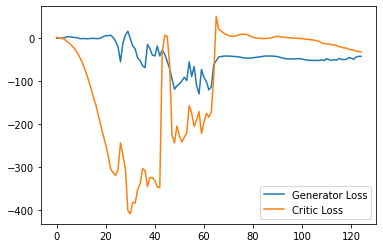

Step 2550: Generator loss: -41.21126234054565, critic loss: -31.36318772125243


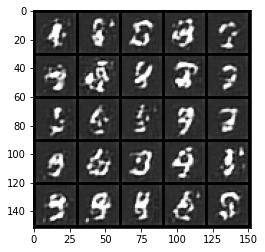

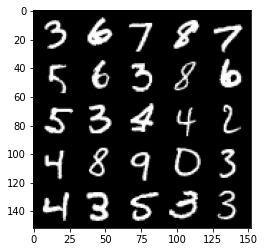

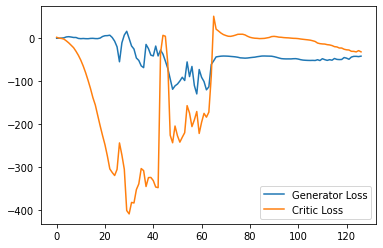

Step 2600: Generator loss: -40.473846702575685, critic loss: -36.7839317703247


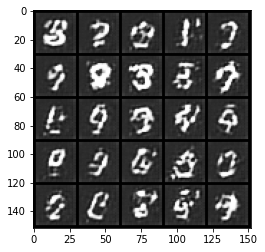

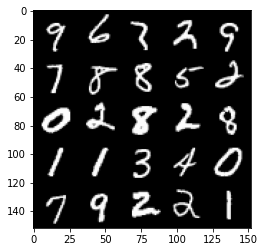

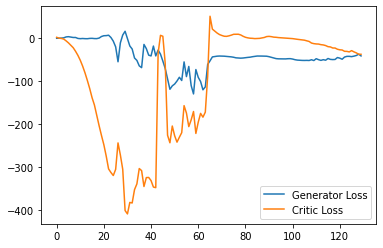

Step 2650: Generator loss: -40.93223234176636, critic loss: -40.34070097351074


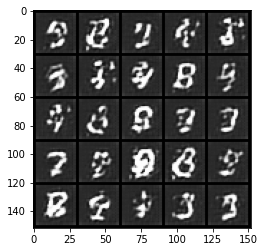

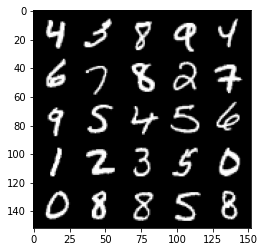

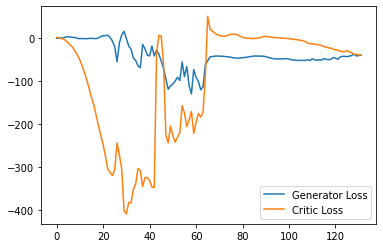

Step 2700: Generator loss: -42.06610467910767, critic loss: -37.638422462463375


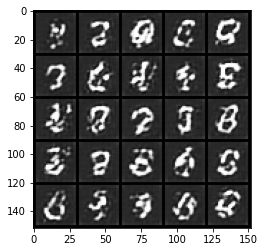

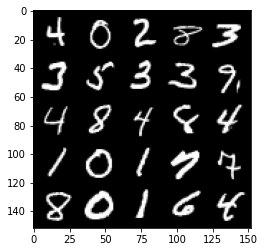

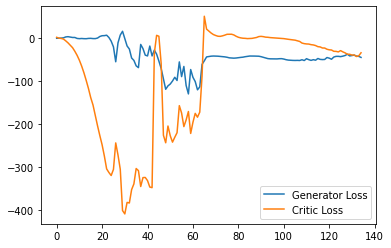

Step 2750: Generator loss: -41.15018455505371, critic loss: -42.2956653251648


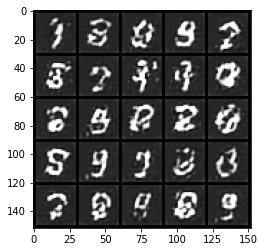

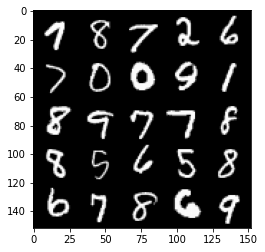

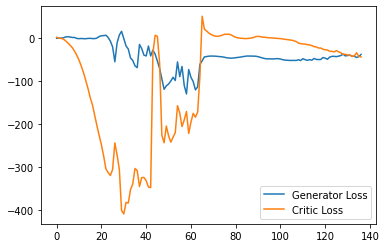

Step 2800: Generator loss: -42.58370040893555, critic loss: -34.66761389923096


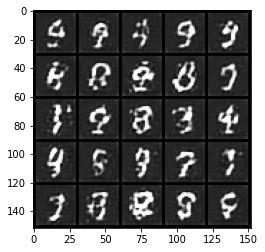

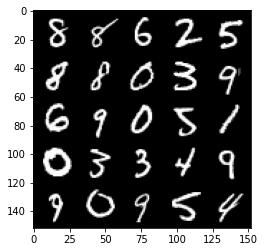

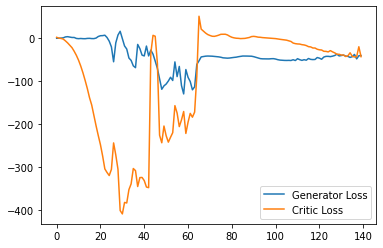

Step 2850: Generator loss: -40.54624122619629, critic loss: -37.35181186294555


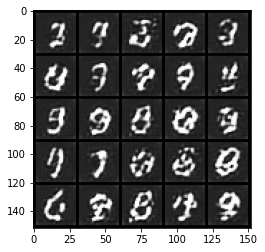

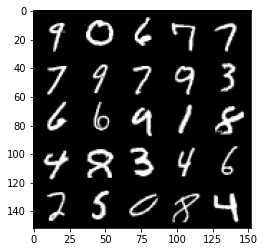

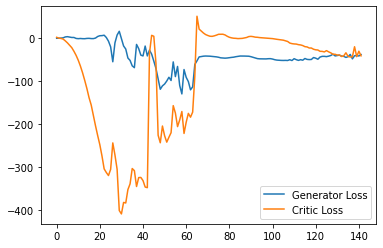

Step 2900: Generator loss: -37.666666679382324, critic loss: -45.49409761810304


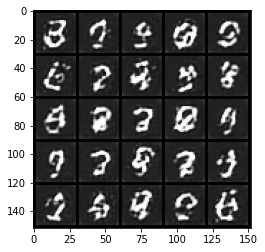

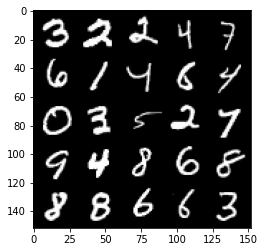

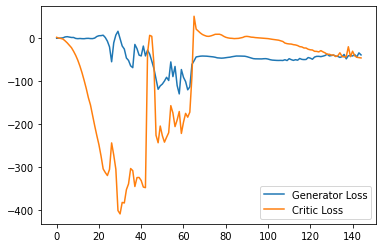

Step 2950: Generator loss: -37.035025119781494, critic loss: -42.22610241699219


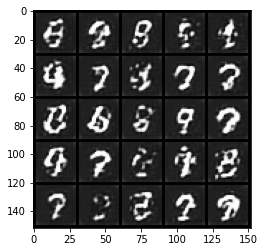

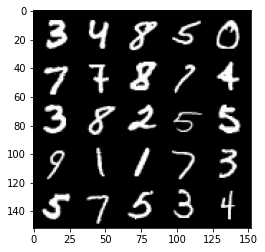

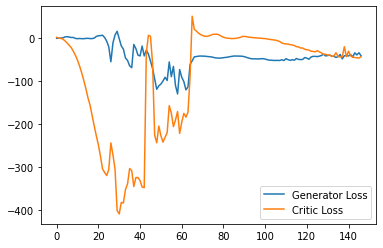

Step 3000: Generator loss: -41.988852977752686, critic loss: -26.326240949630748


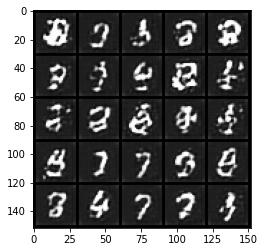

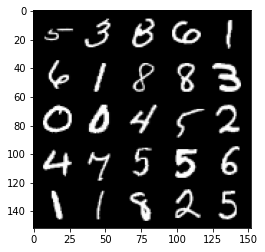

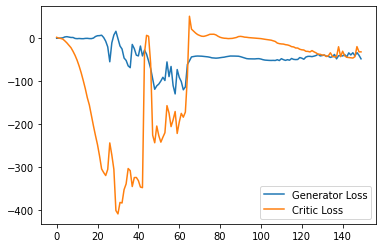

Step 3050: Generator loss: -38.87220733642578, critic loss: -13.593860997200013


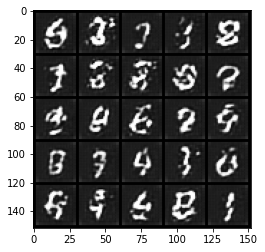

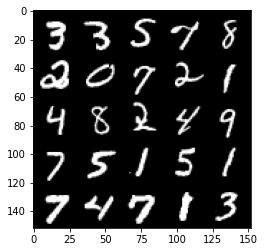

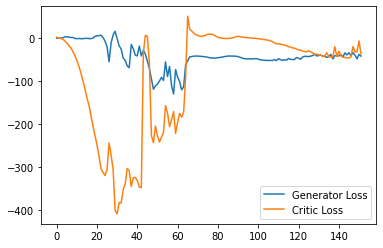

Step 3100: Generator loss: -35.69223861694336, critic loss: -2.820039689064026


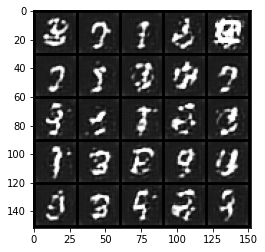

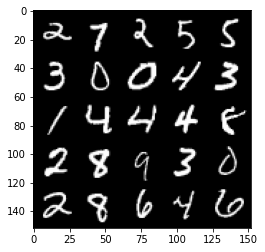

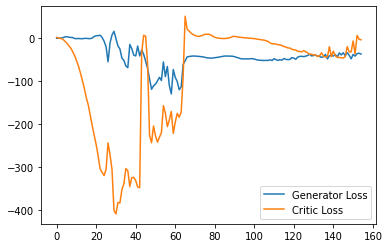

Step 3150: Generator loss: -48.38349708557129, critic loss: -27.6639361114502


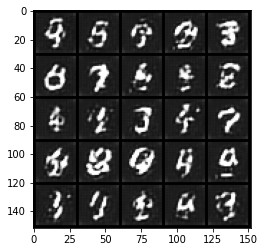

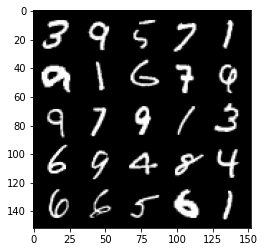

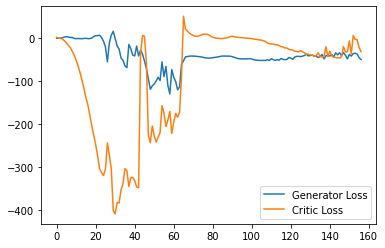

Step 3200: Generator loss: -42.262920455932615, critic loss: -15.913490740776062


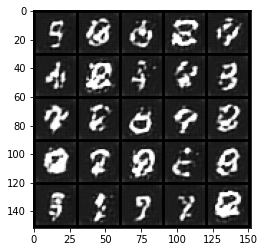

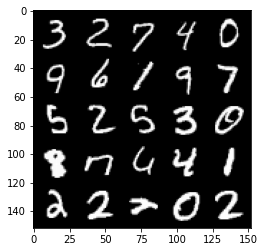

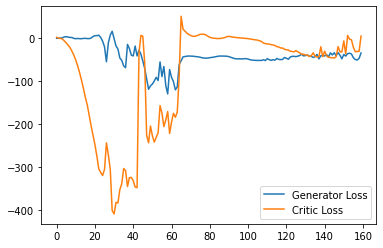

Step 3250: Generator loss: -35.66510551452637, critic loss: -1.6582817859649654


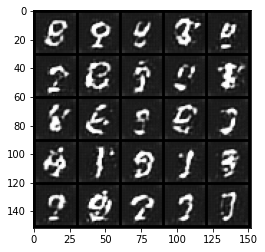

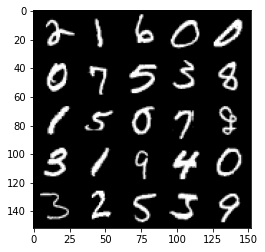

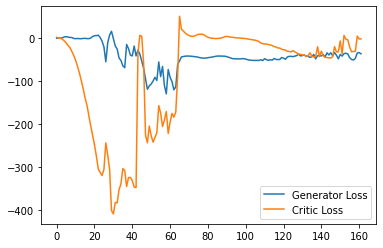

Step 3300: Generator loss: -41.59501152038574, critic loss: -2.0529442157745366


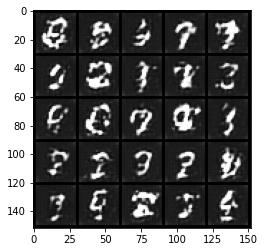

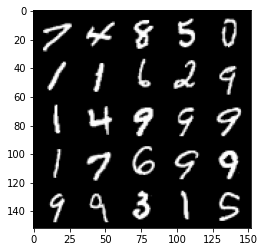

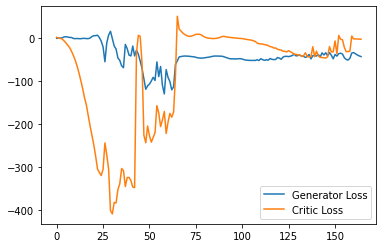

Step 3350: Generator loss: -44.13051620483398, critic loss: -3.234642206192017


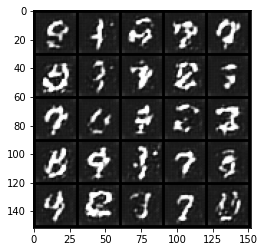

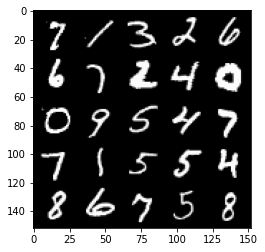

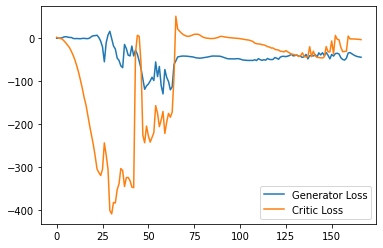

Step 3400: Generator loss: -48.37680438995361, critic loss: -17.98140517997741


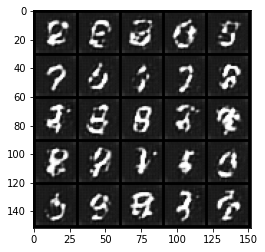

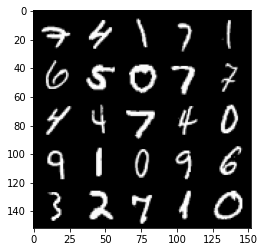

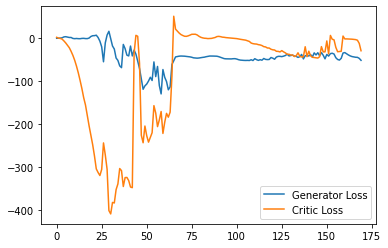

Step 3450: Generator loss: -47.26001266479492, critic loss: -23.897115139007575


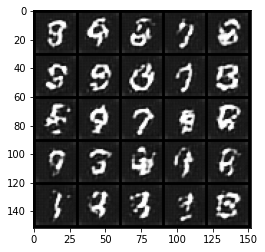

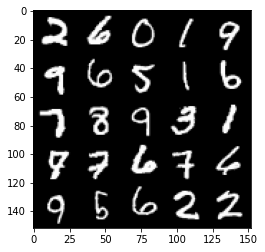

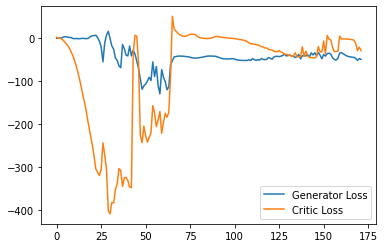

Step 3500: Generator loss: -41.45077346801758, critic loss: -8.629115262031558


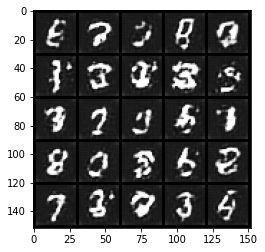

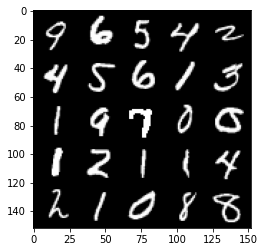

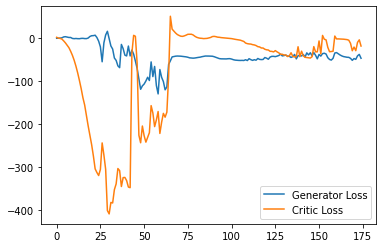

Step 3550: Generator loss: -48.21476890563965, critic loss: -24.466084730148317


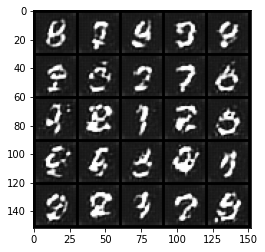

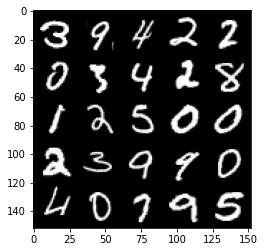

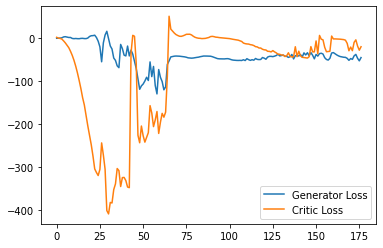

Step 3600: Generator loss: -46.15376495361328, critic loss: -18.964099928855898


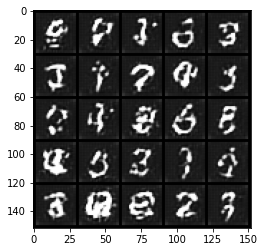

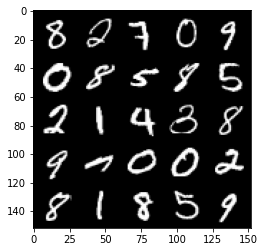

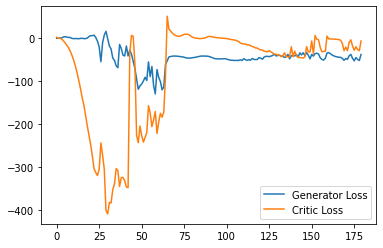

Step 3650: Generator loss: -47.075830955505374, critic loss: -21.696078924179076


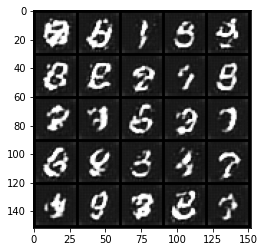

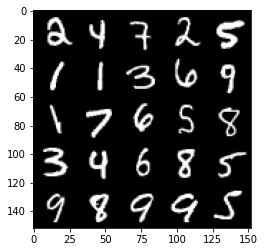

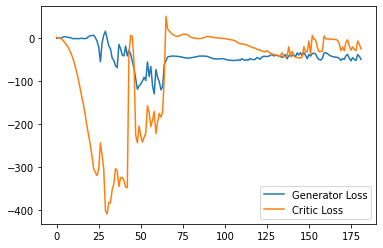

Step 3700: Generator loss: -44.98467174530029, critic loss: -23.62810041999817


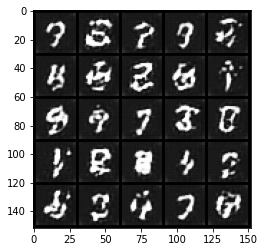

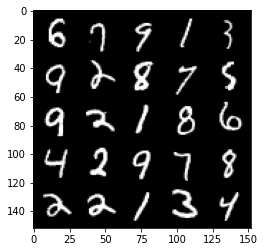

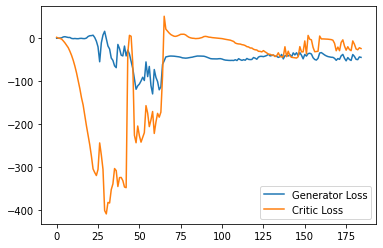

Step 3750: Generator loss: -44.46049503326416, critic loss: -22.601852795600884


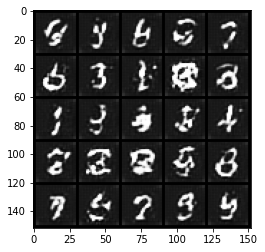

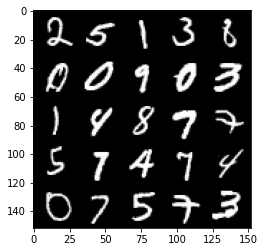

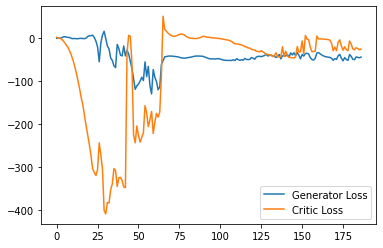

Step 3800: Generator loss: -41.899840202331546, critic loss: -23.08310968589782


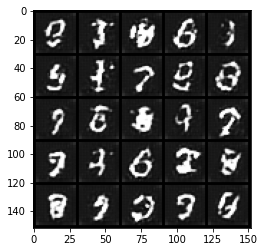

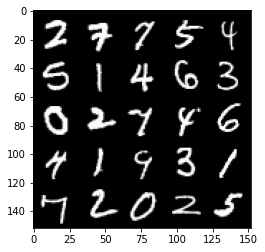

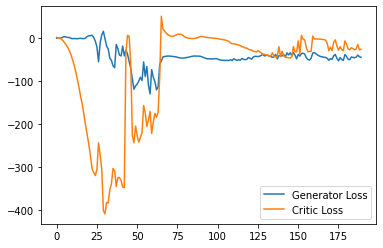

Step 3850: Generator loss: -41.83721187591553, critic loss: -21.504725850105284


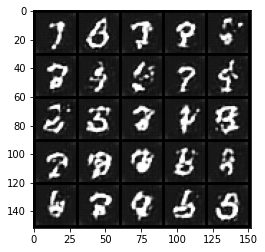

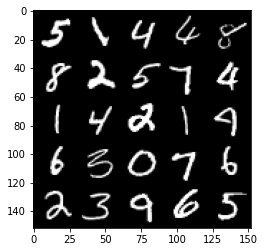

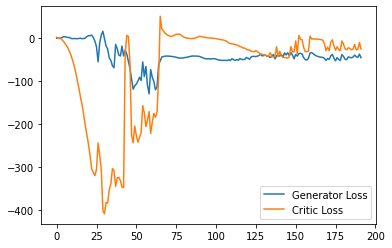

Step 3900: Generator loss: -37.110586128234864, critic loss: -22.71077204036713


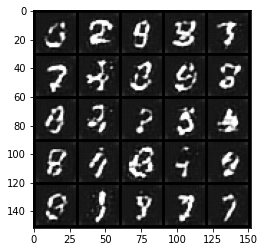

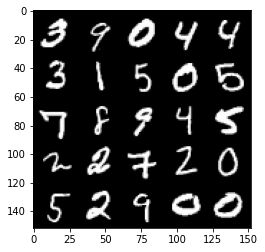

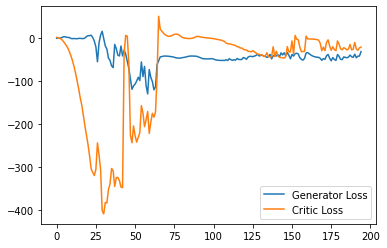

Step 3950: Generator loss: -43.14389495849609, critic loss: -24.375878143310537


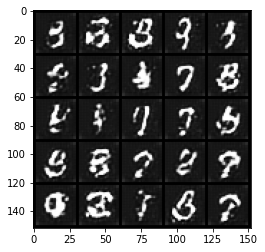

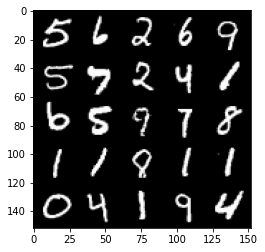

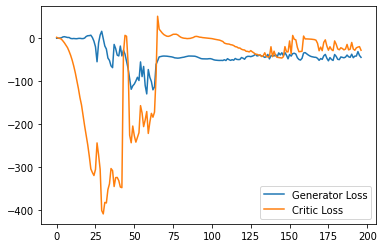

Step 4000: Generator loss: -38.81245807647705, critic loss: -18.27859111785889


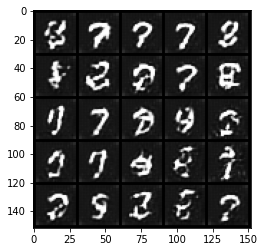

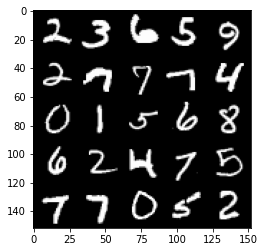

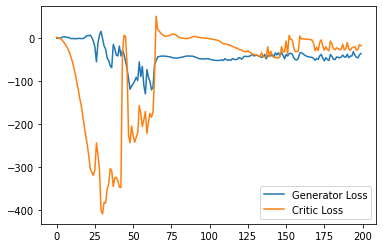

Step 4050: Generator loss: -39.57426557540894, critic loss: -20.09179208660126


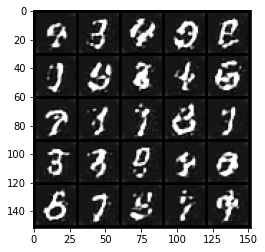

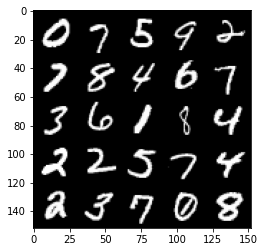

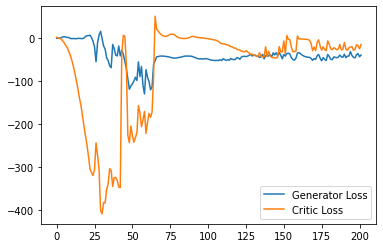

Step 4100: Generator loss: -34.96895515441894, critic loss: -4.32030849647522


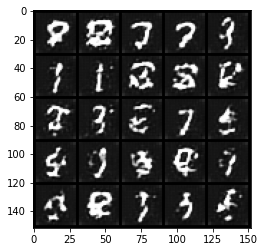

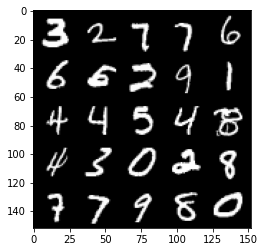

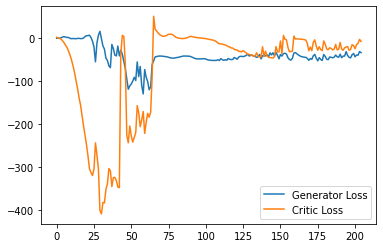

Step 4150: Generator loss: -42.72784950256348, critic loss: -24.1496220779419


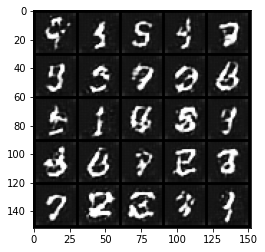

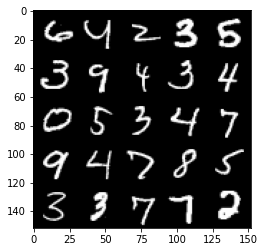

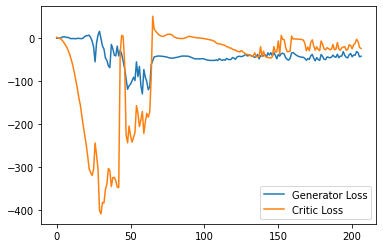

Step 4200: Generator loss: -36.61139698028565, critic loss: -17.82134016609192


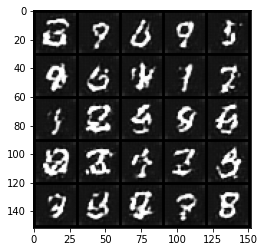

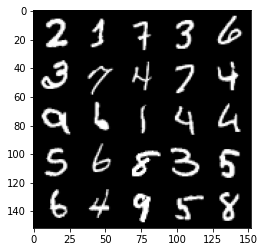

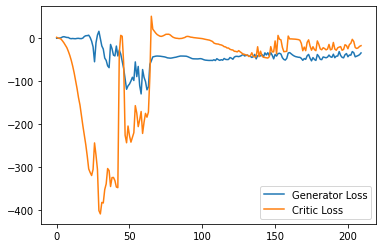

Step 4250: Generator loss: -38.63262626647949, critic loss: -17.929629396438596


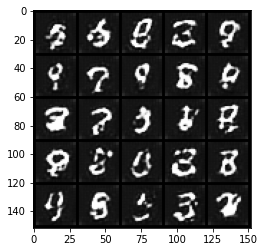

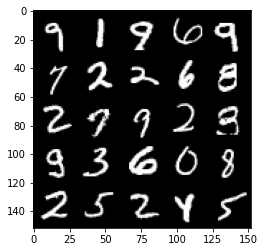

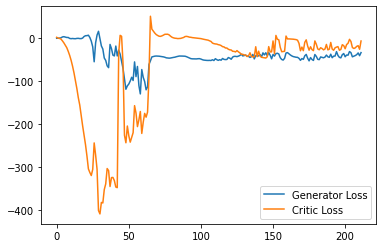

Step 4300: Generator loss: -41.990243453979495, critic loss: -25.016583480834957


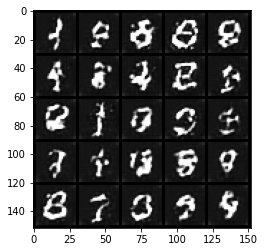

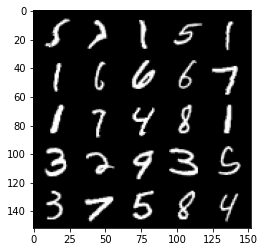

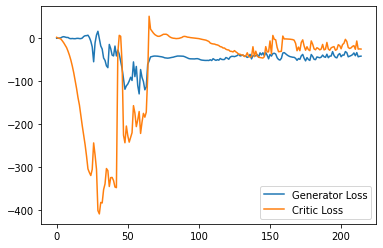

Step 4350: Generator loss: -33.01254280090332, critic loss: -6.203038779735563


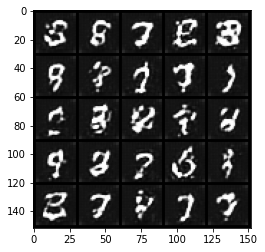

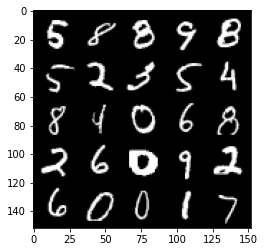

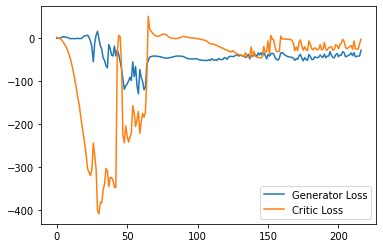

Step 4400: Generator loss: -35.69262855529785, critic loss: -12.458916608810425


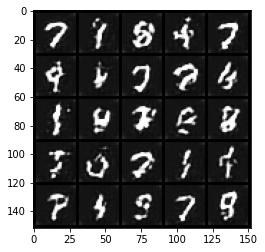

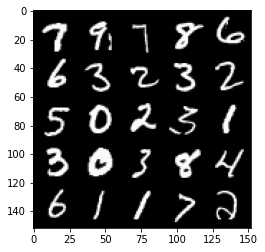

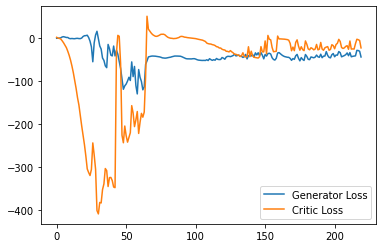

Step 4450: Generator loss: -35.138861980438236, critic loss: -9.062762850761413


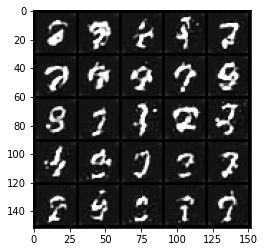

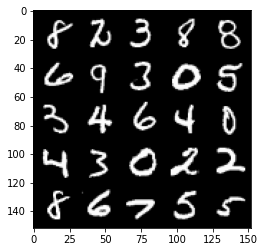

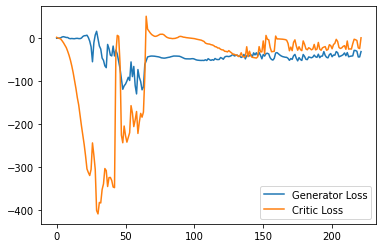

Step 4500: Generator loss: -30.273138885498046, critic loss: -1.9873992848396298


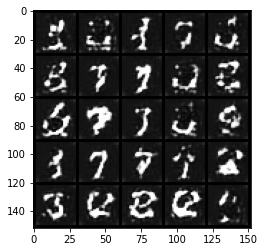

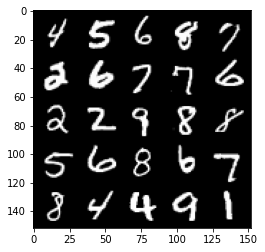

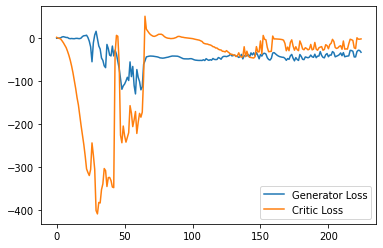

Step 4550: Generator loss: -35.209916305541995, critic loss: -3.353805735588074


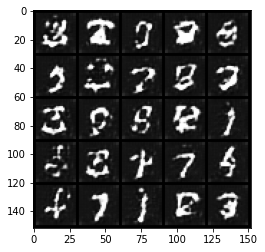

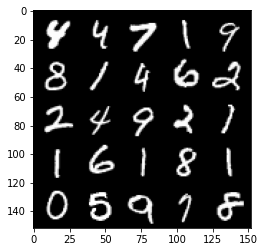

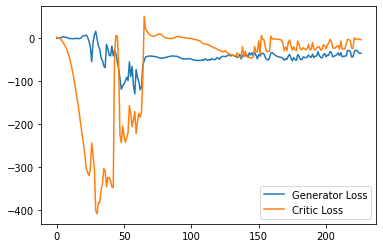

Step 4600: Generator loss: -37.619941062927246, critic loss: -8.985191319465638


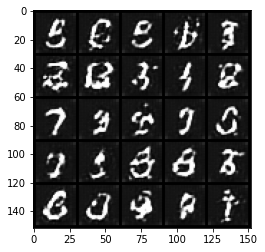

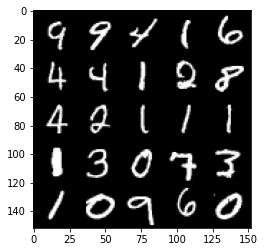

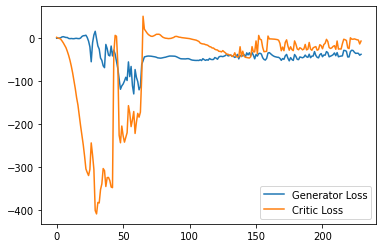

Step 4650: Generator loss: -37.75118110656738, critic loss: -12.31651184988022


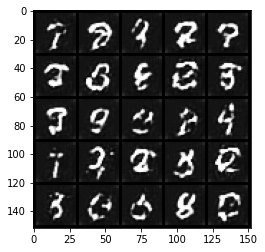

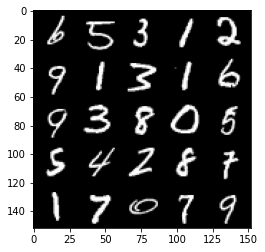

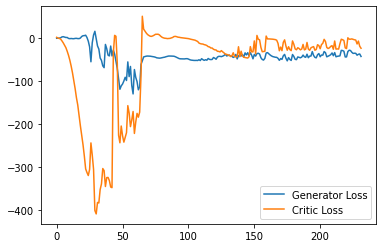

Step 4700: Generator loss: -29.713805961608887, critic loss: -2.4511434659957887


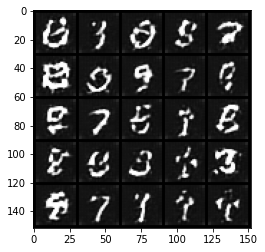

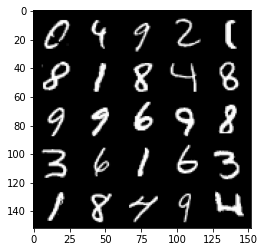

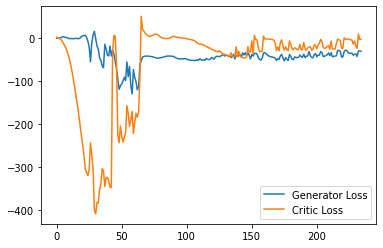

Step 4750: Generator loss: -32.97260471343994, critic loss: -2.5556516656875607


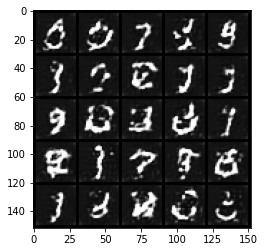

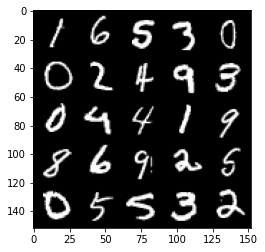

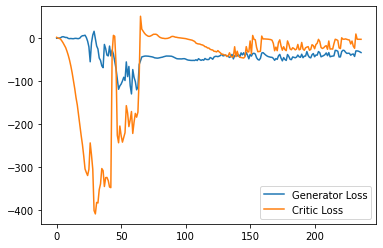

Step 4800: Generator loss: -36.563945846557615, critic loss: -3.369540839195251


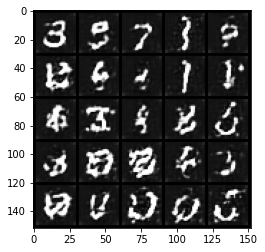

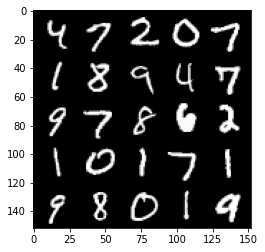

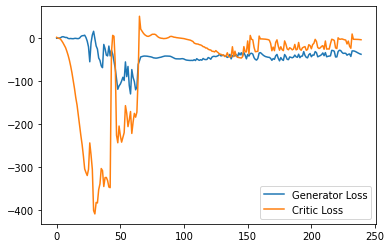

Step 4850: Generator loss: -44.0268221282959, critic loss: -14.538424228191378


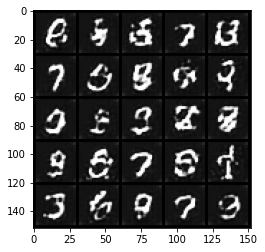

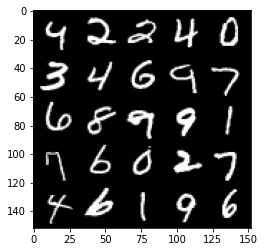

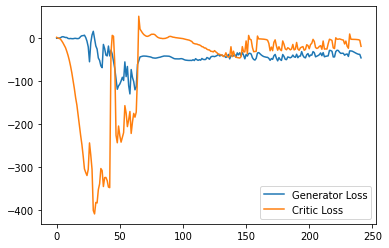

Step 4900: Generator loss: -33.460083656311035, critic loss: -4.758216858386992


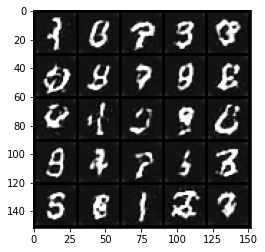

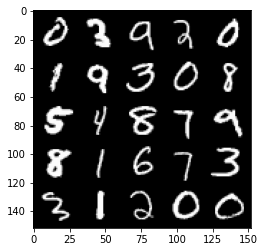

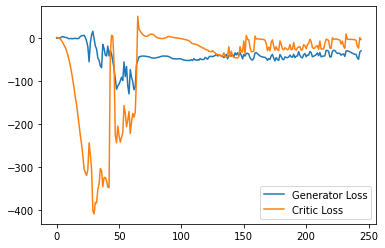

Step 4950: Generator loss: -34.09800064086914, critic loss: -3.5435689163208024


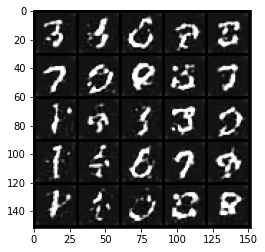

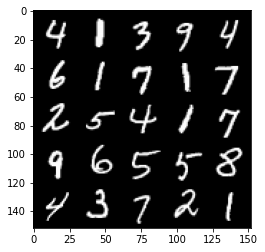

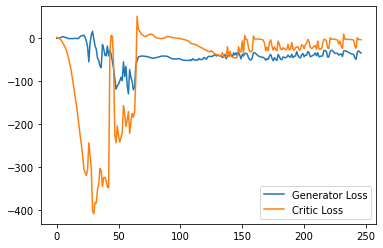

Step 5000: Generator loss: -40.94845344543457, critic loss: -10.981773369789122


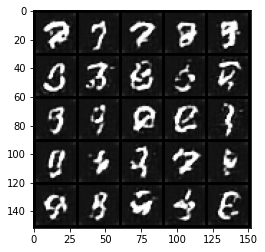

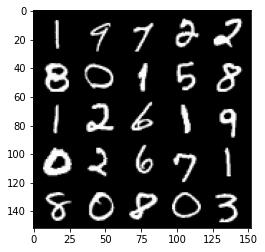

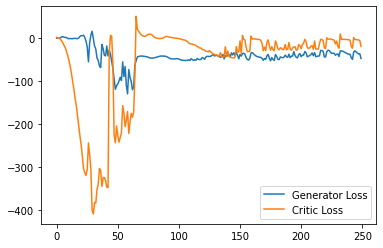

Step 5050: Generator loss: -33.19345806121826, critic loss: -3.603805850982665


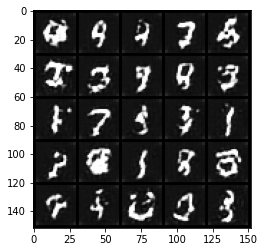

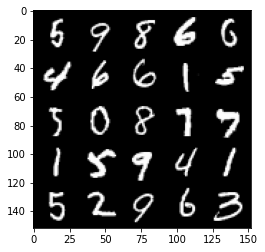

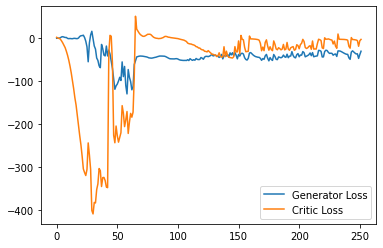

Step 5100: Generator loss: -37.47337562561035, critic loss: -7.3161382904052745


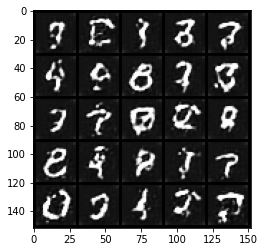

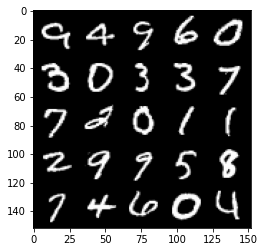

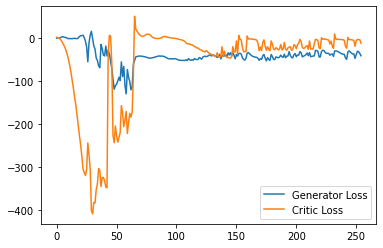

Step 5150: Generator loss: -35.218541297912594, critic loss: -6.561749757766723


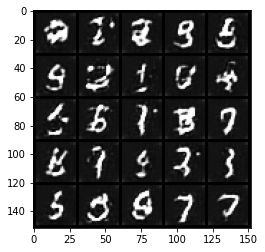

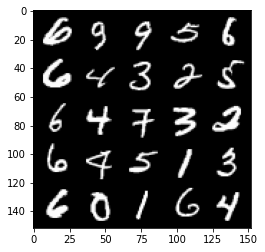

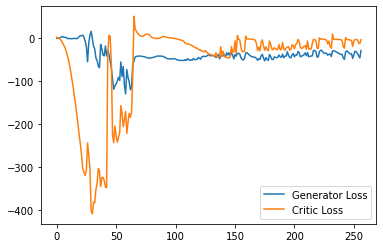

Step 5200: Generator loss: -32.578964691162106, critic loss: -4.345668267250061


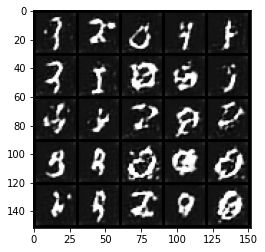

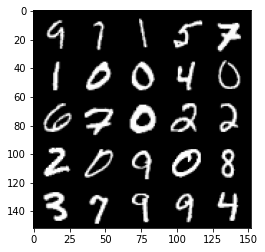

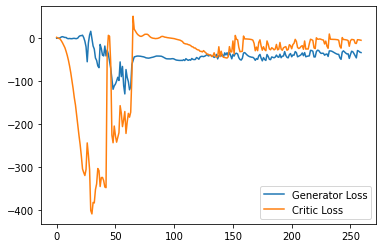

Step 5250: Generator loss: -35.491788940429686, critic loss: -6.695003747940064


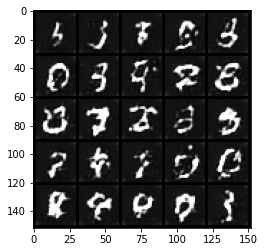

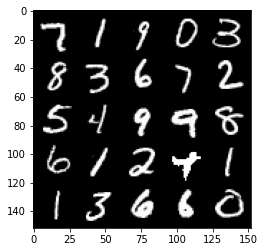

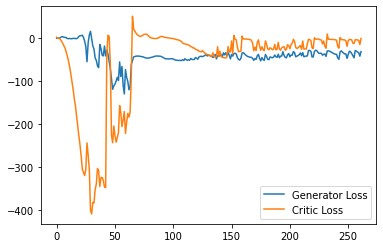

Step 5300: Generator loss: -36.63126049041748, critic loss: -8.198489330291746


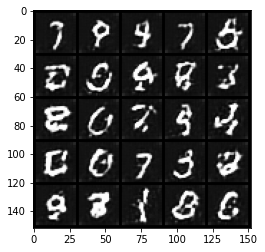

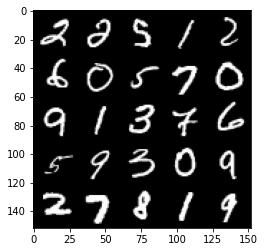

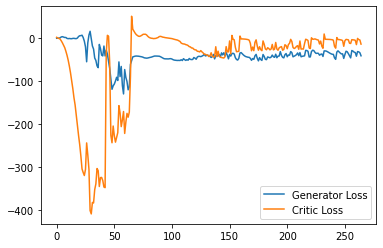

Step 5350: Generator loss: -32.20387237548828, critic loss: 0.20709060192108109


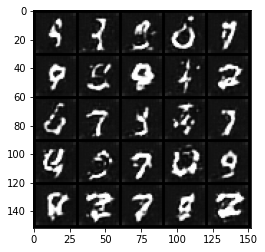

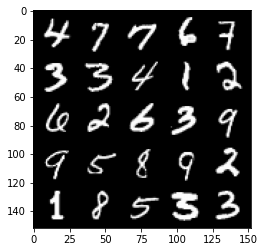

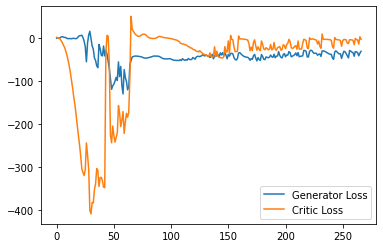

Step 5400: Generator loss: -34.96635787963867, critic loss: -3.40275457572937


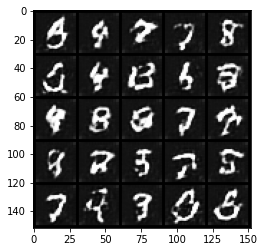

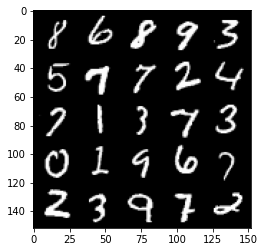

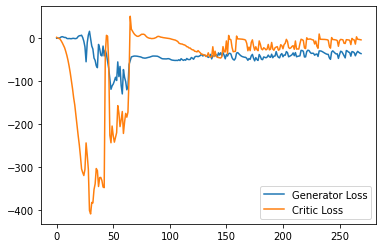

Step 5450: Generator loss: -39.94090751647949, critic loss: -5.250806140422823


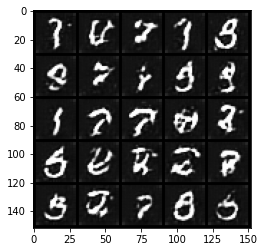

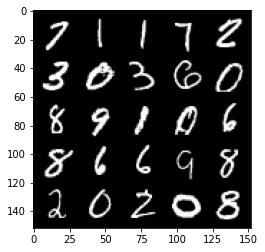

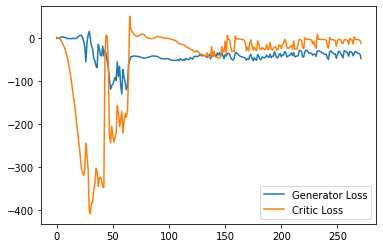

Step 5500: Generator loss: -30.88651454925537, critic loss: -2.474917044639588


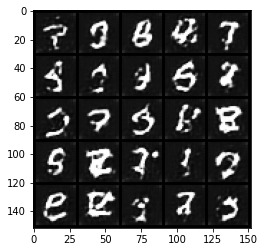

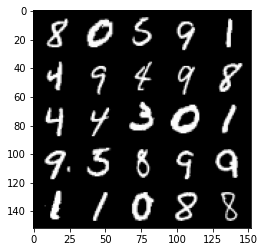

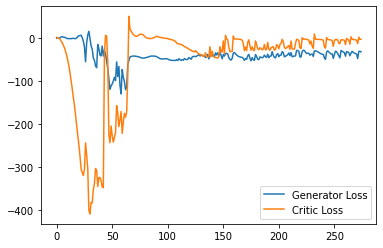

Step 5550: Generator loss: -34.042794647216795, critic loss: -2.6676698474884035


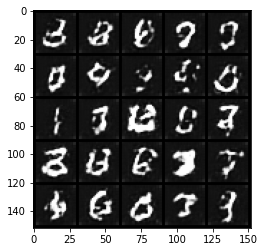

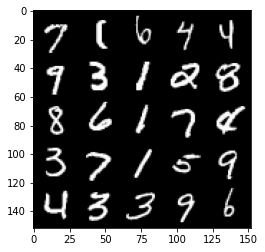

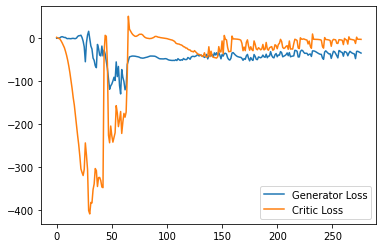

Step 5600: Generator loss: -35.51096336364746, critic loss: -3.486243356704711


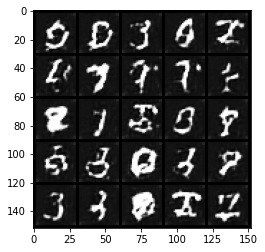

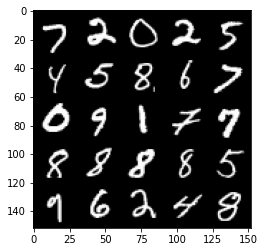

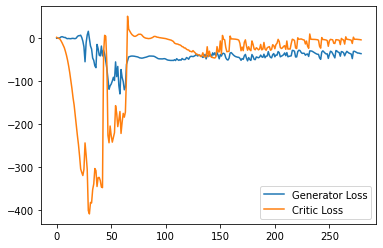

Step 5650: Generator loss: -36.85383026123047, critic loss: -4.57983699131012


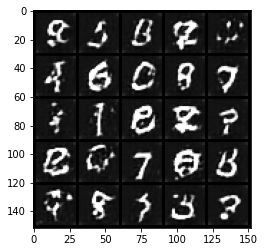

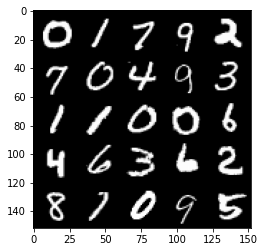

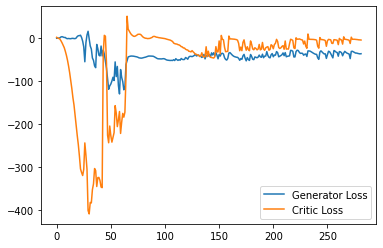

Step 5700: Generator loss: -36.76882438659668, critic loss: -5.948212898254393


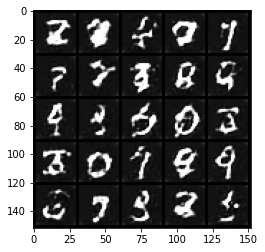

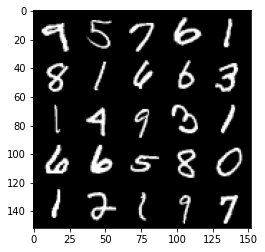

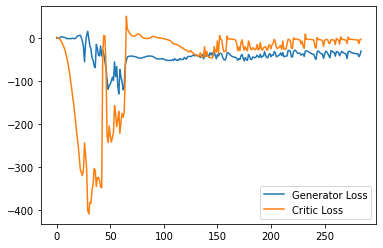

Step 5750: Generator loss: -34.07632049560547, critic loss: -3.0194127054214475


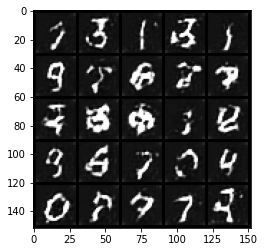

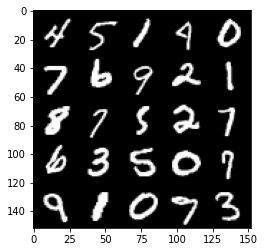

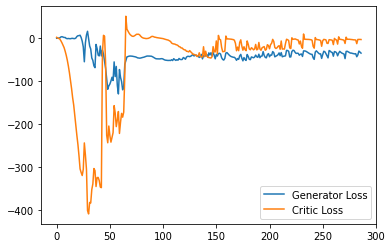

Step 5800: Generator loss: -37.49257568359375, critic loss: -5.14638344669342


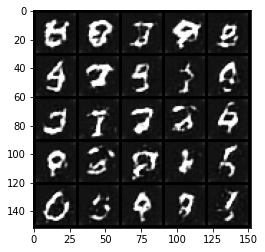

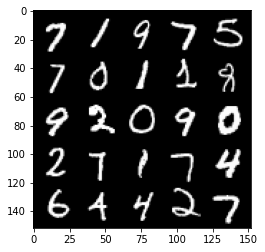

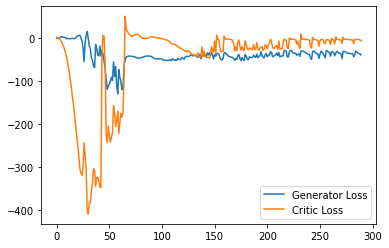

Step 5850: Generator loss: -35.107802734375, critic loss: 1.6812387480735784


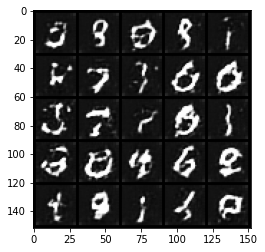

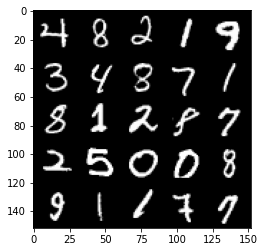

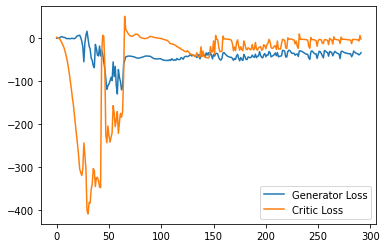

Step 5900: Generator loss: -36.88606559753418, critic loss: -2.0363191547393793


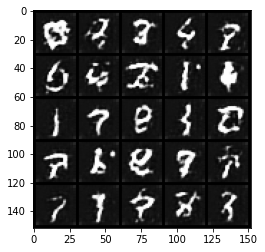

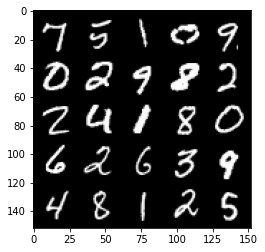

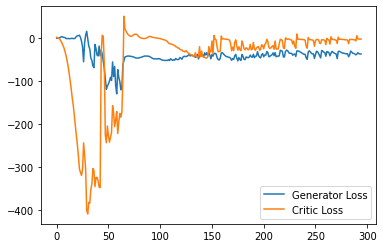

Step 5950: Generator loss: -37.0597127532959, critic loss: -2.3721319146156308


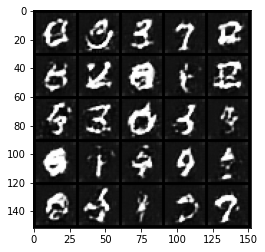

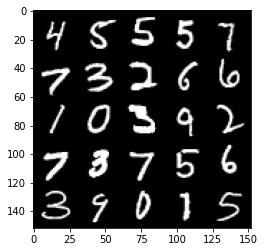

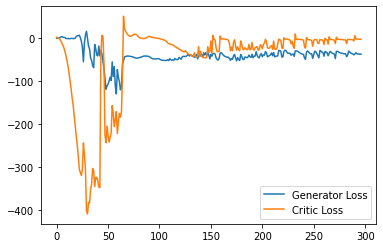

Step 6000: Generator loss: -36.74750038146973, critic loss: -2.9005786066055292


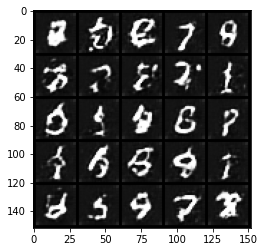

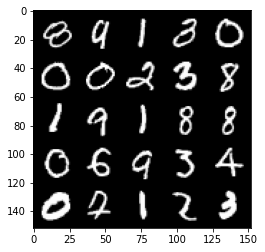

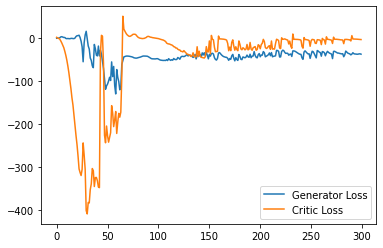

Step 6050: Generator loss: -37.77242584228516, critic loss: -3.716424146652222


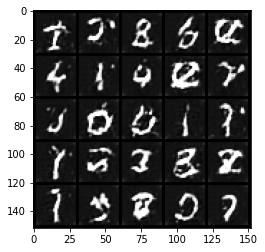

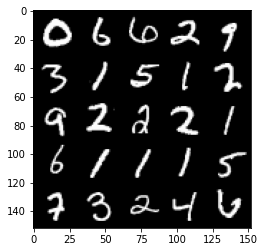

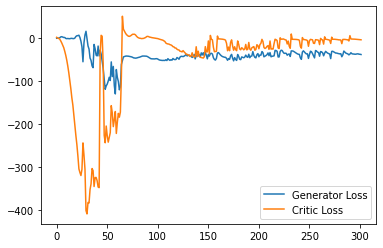

Step 6100: Generator loss: -38.505193367004395, critic loss: -5.799930535793305


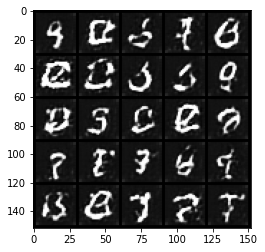

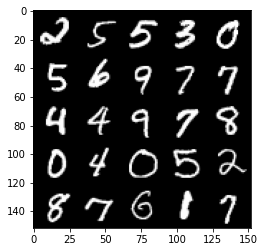

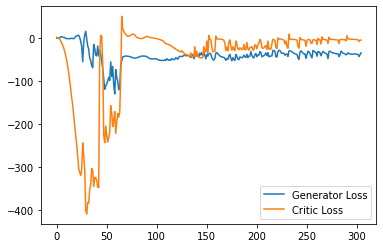

Step 6150: Generator loss: -47.75792350769043, critic loss: -18.840215607643128


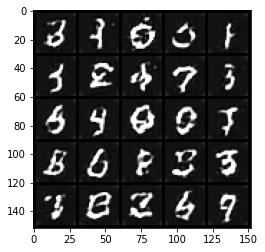

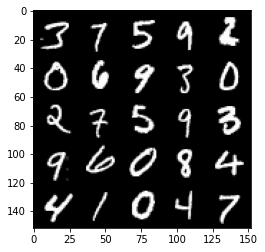

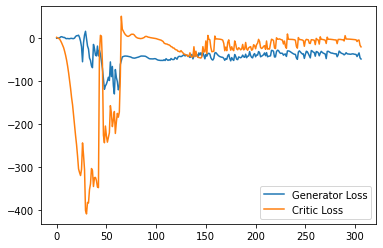

Step 6200: Generator loss: -46.34263862609863, critic loss: -19.921597793102265


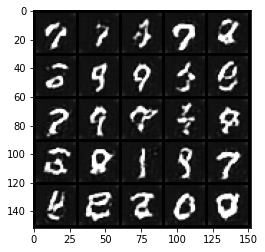

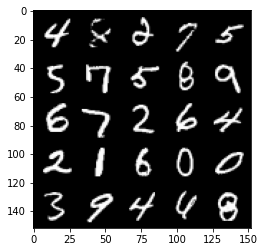

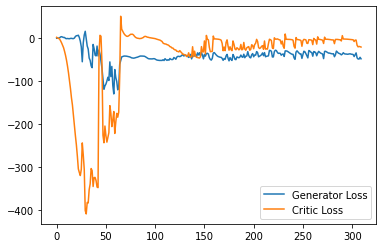

Step 6250: Generator loss: -48.84314041137695, critic loss: -13.895160814285282


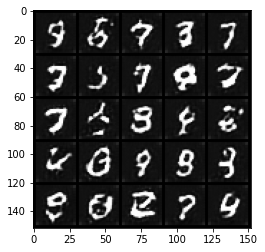

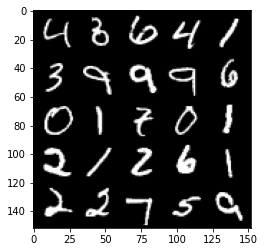

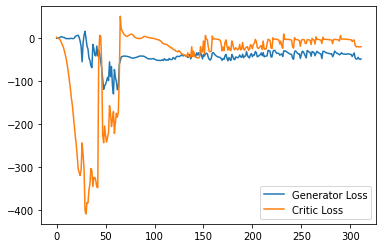

Step 6300: Generator loss: -33.73113437652588, critic loss: -2.8071686038970944


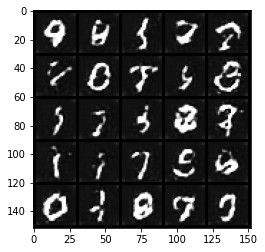

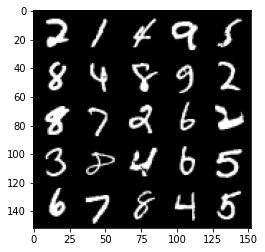

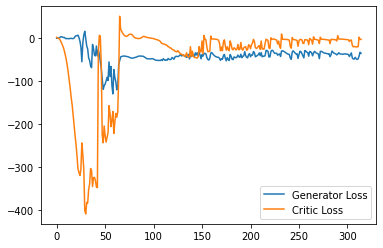

Step 6350: Generator loss: -38.457696762084964, critic loss: -2.9331244029998778


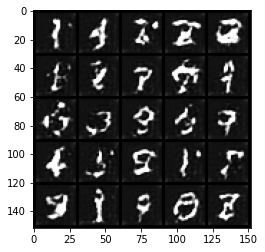

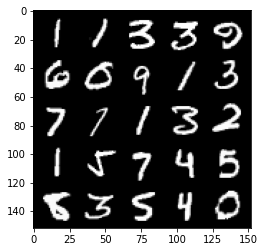

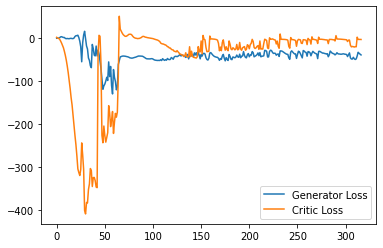

Step 6400: Generator loss: -40.246500701904296, critic loss: -4.875730752944947


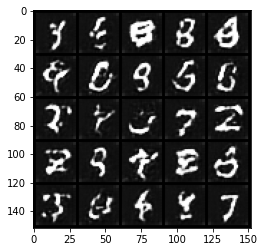

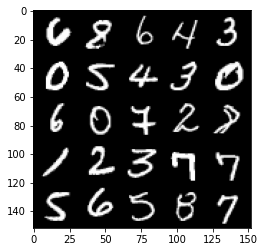

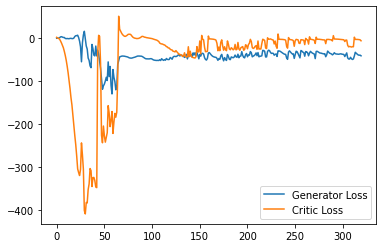

Step 6450: Generator loss: -48.782683563232425, critic loss: -12.878275599956515


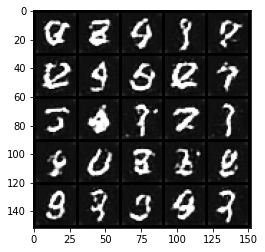

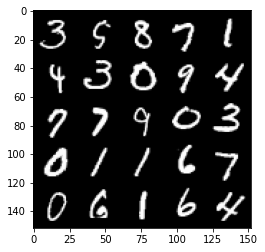

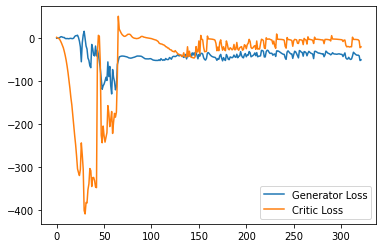

Step 6500: Generator loss: -35.533841934204105, critic loss: -2.844521947860718


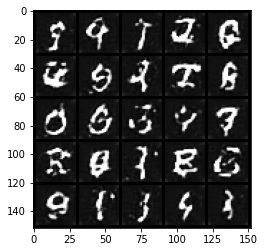

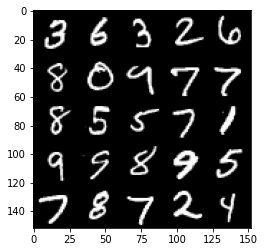

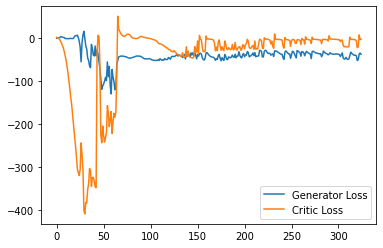

Step 6550: Generator loss: -39.47181564331055, critic loss: -3.0708260784149184


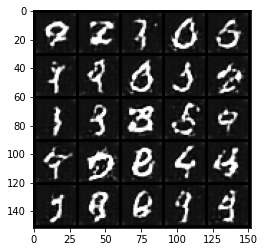

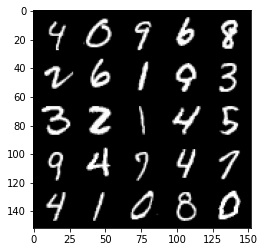

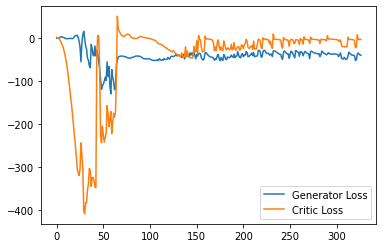

Step 6600: Generator loss: -41.080528564453125, critic loss: -3.7384688134193427


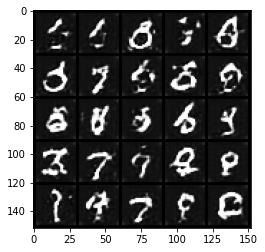

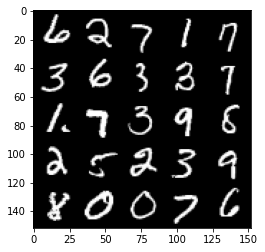

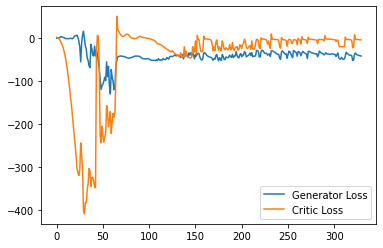

Step 6650: Generator loss: -43.77828140258789, critic loss: -6.378444816589356


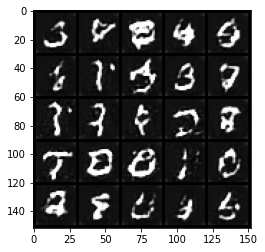

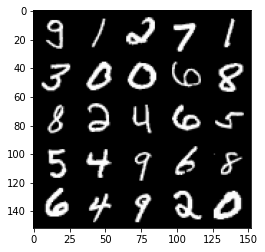

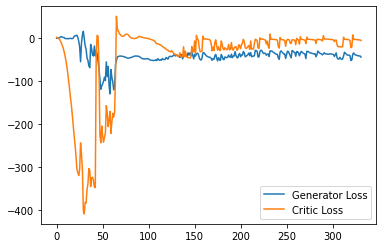

Step 6700: Generator loss: -51.013119583129885, critic loss: -15.048353488683704


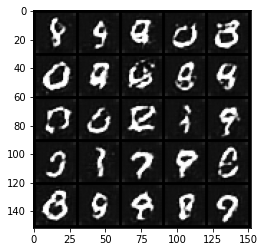

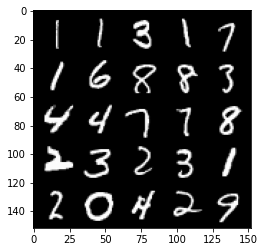

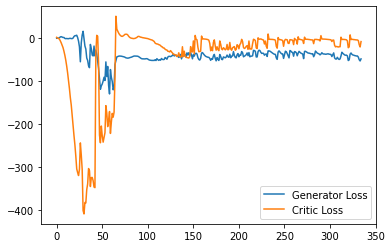

Step 6750: Generator loss: -51.87041549682617, critic loss: -20.916676270961766


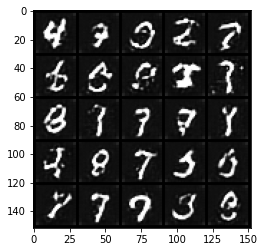

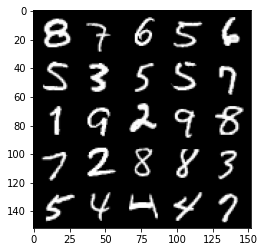

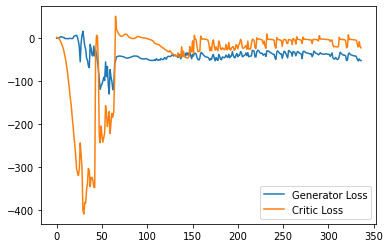

Step 6800: Generator loss: -52.74265876770019, critic loss: -19.17096365070343


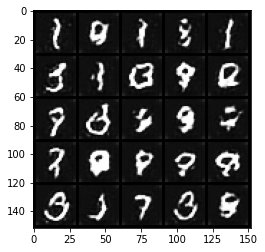

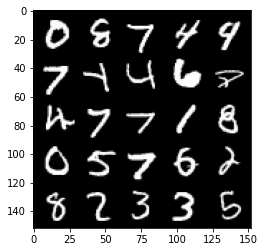

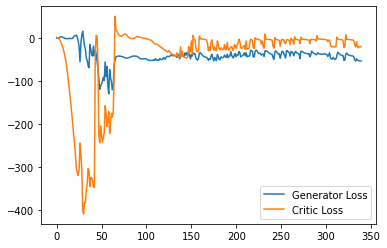

Step 6850: Generator loss: -51.67332023620605, critic loss: -18.925771305084233


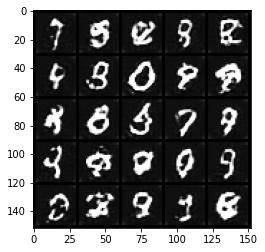

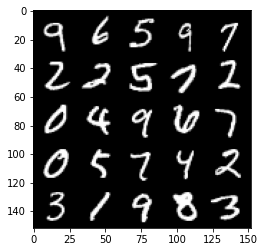

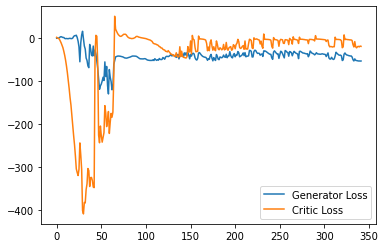

Step 6900: Generator loss: -49.5449210357666, critic loss: -8.077477743148801


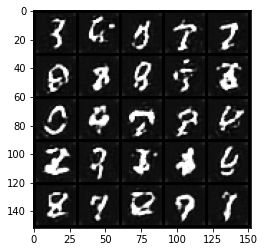

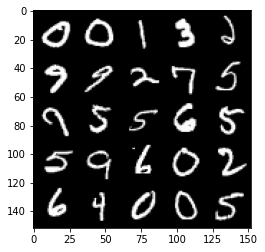

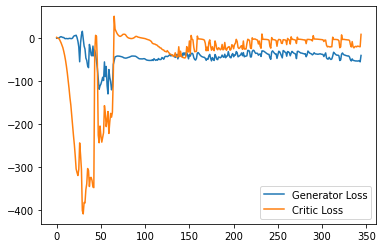

Step 6950: Generator loss: -40.491164169311524, critic loss: -3.4847903089523307


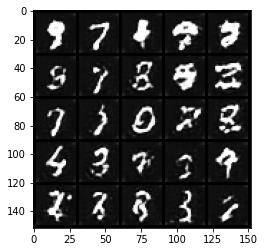

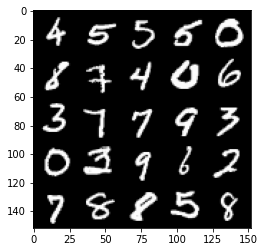

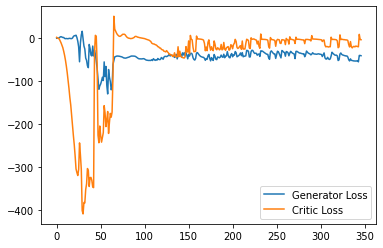

Step 7000: Generator loss: -47.441200485229494, critic loss: -10.071692176818846


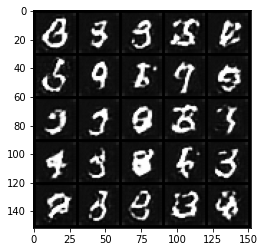

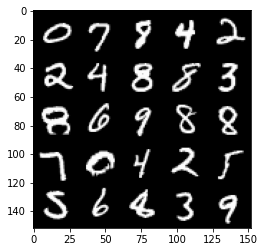

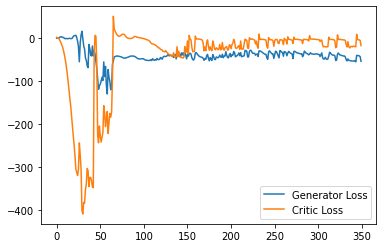

Step 7050: Generator loss: -53.81378067016602, critic loss: -20.8001783528328


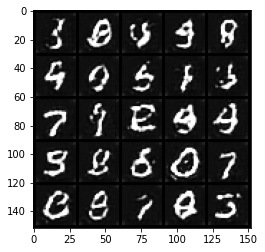

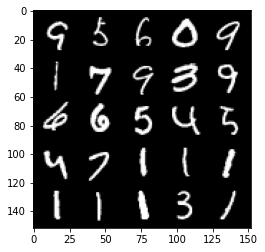

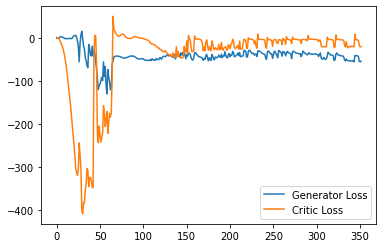

Step 7100: Generator loss: -47.44986373901367, critic loss: -15.450318029642105


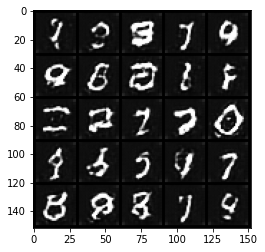

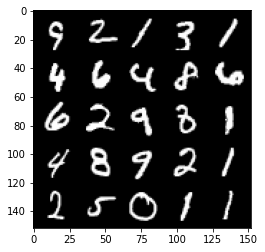

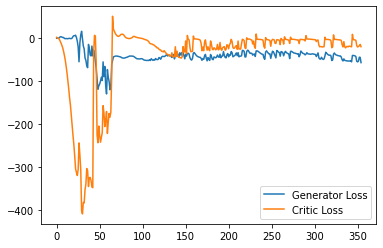

Step 7150: Generator loss: -56.17896392822266, critic loss: -19.226418131351473


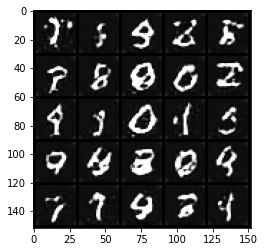

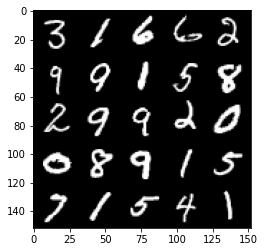

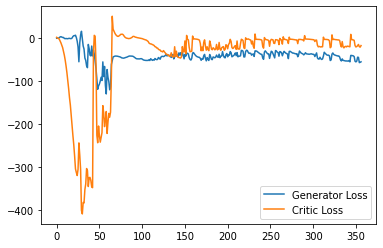

Step 7200: Generator loss: -44.20298072814941, critic loss: -3.1982206630706793


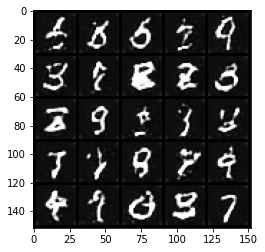

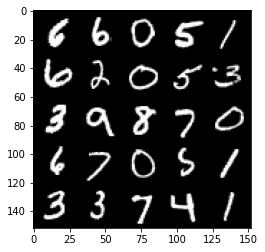

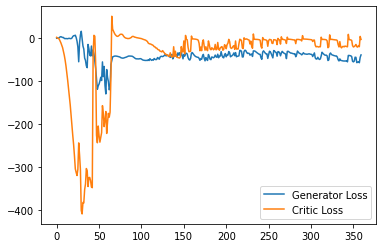

Step 7250: Generator loss: -40.843312911987304, critic loss: -2.8461451482772833


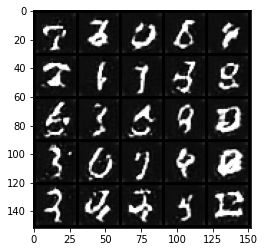

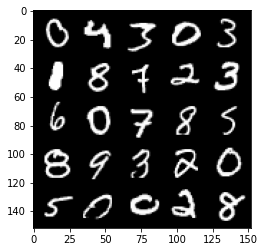

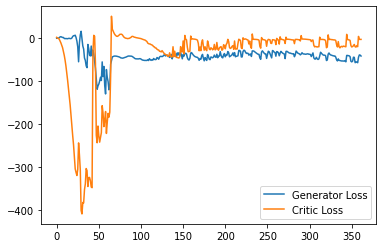

Step 7300: Generator loss: -47.46655799865723, critic loss: -5.947490791082382


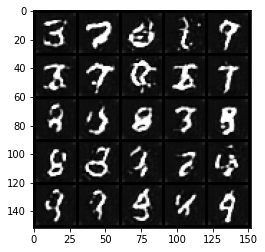

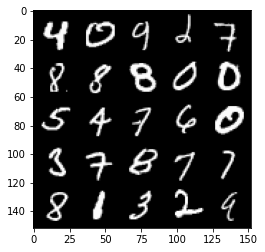

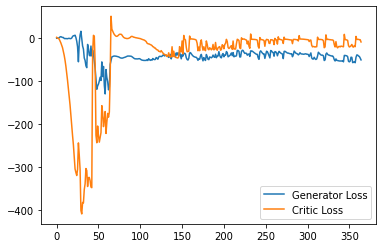

Step 7350: Generator loss: -57.46261276245117, critic loss: -20.48319812822342


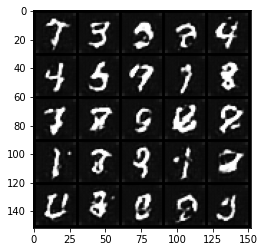

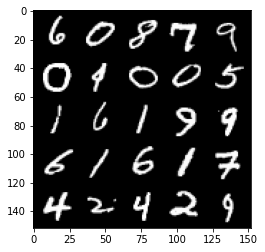

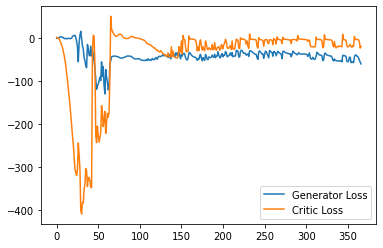

Step 7400: Generator loss: -55.27760154724121, critic loss: -20.705760571002962


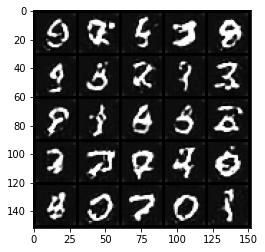

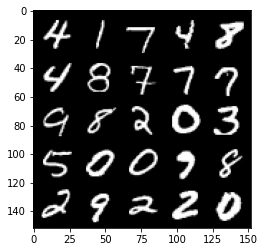

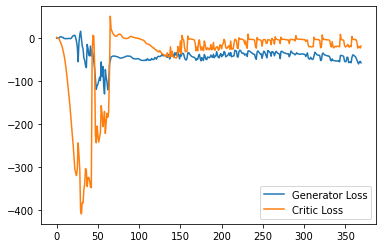

Step 7450: Generator loss: -50.57070022583008, critic loss: -10.55969377064705


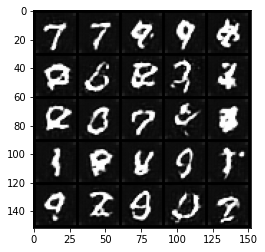

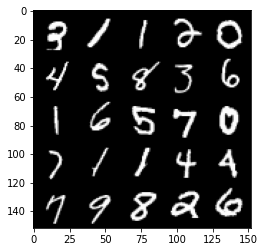

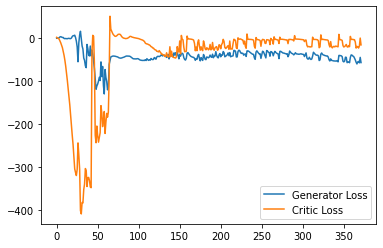

Step 7500: Generator loss: -47.54683486938477, critic loss: -12.908584866046908


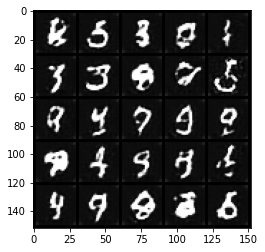

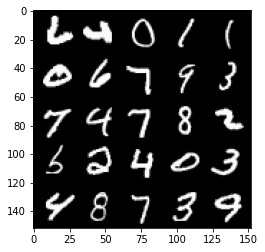

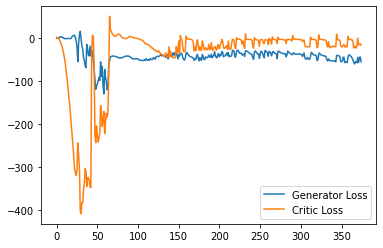

Step 7550: Generator loss: -51.84321071624756, critic loss: -12.499970764160162


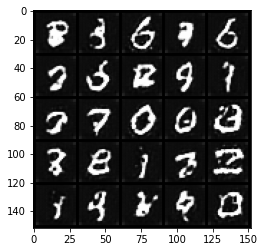

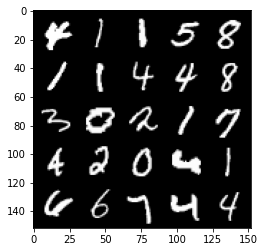

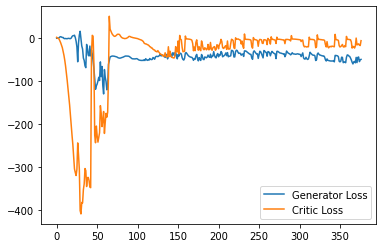

Step 7600: Generator loss: -56.54618492126465, critic loss: -17.921215172767642


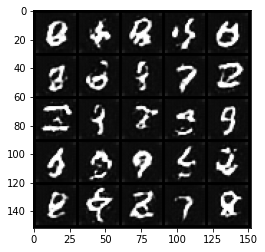

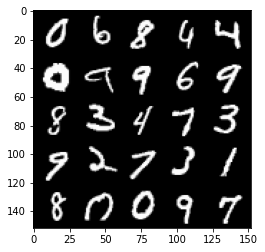

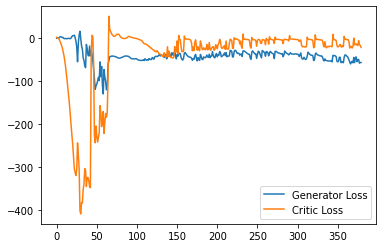

Step 7650: Generator loss: -46.678156814575196, critic loss: -12.178523035526277


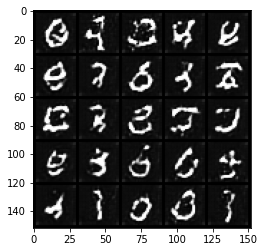

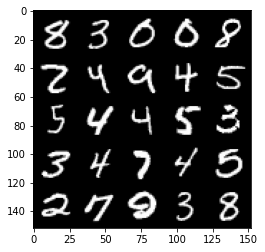

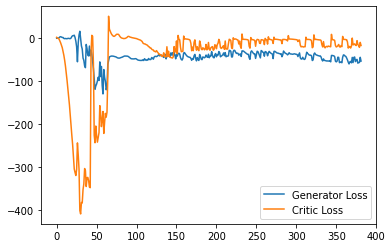

Step 7700: Generator loss: -52.758361434936525, critic loss: -15.69846625566482


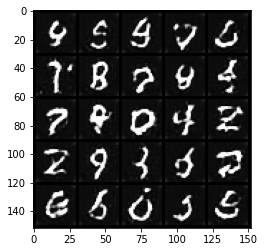

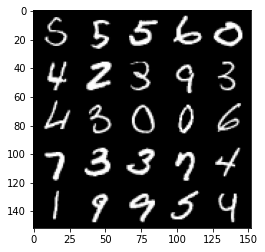

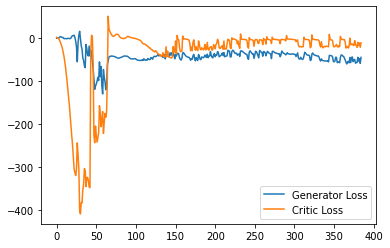

Step 7750: Generator loss: -53.74751968383789, critic loss: -5.8580025353431715


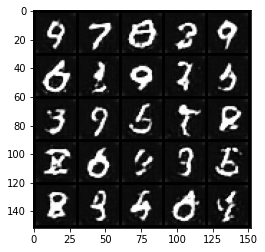

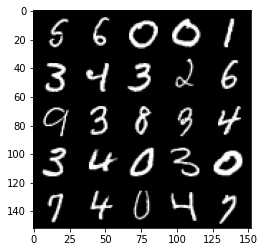

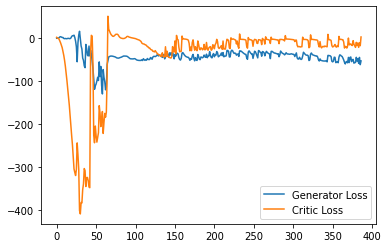

Step 7800: Generator loss: -47.84547729492188, critic loss: -6.627449956655503


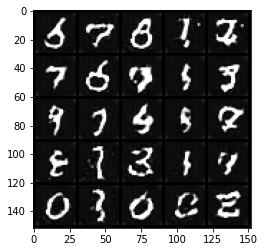

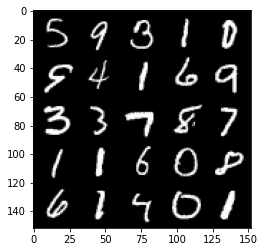

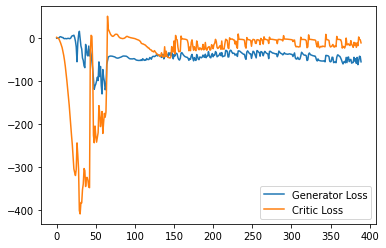

Step 7850: Generator loss: -53.11642555236816, critic loss: -14.00043763566017


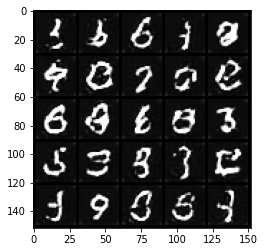

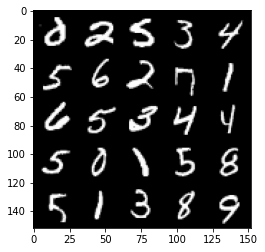

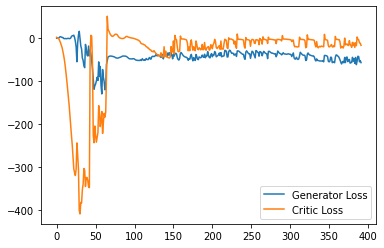

Step 7900: Generator loss: -52.06423614501953, critic loss: -15.50038107252121


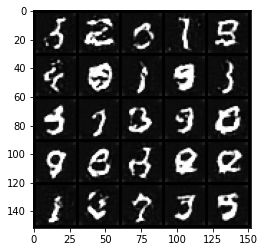

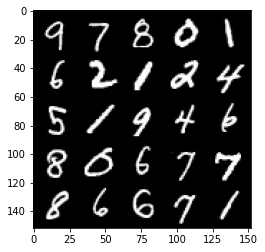

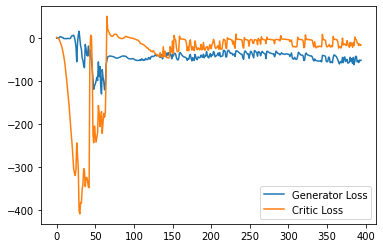

Step 7950: Generator loss: -58.02949089050293, critic loss: -16.93812717914581


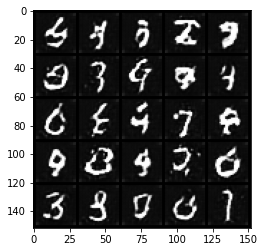

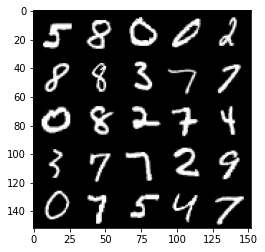

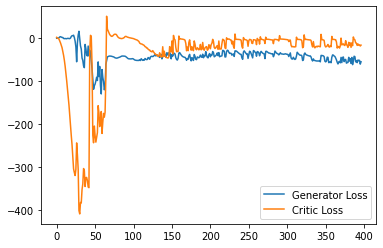

Step 8000: Generator loss: -56.95449501037598, critic loss: -7.976435627937321


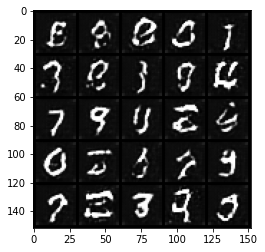

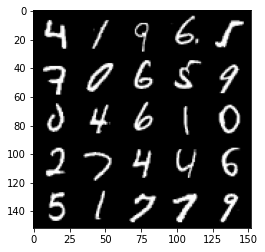

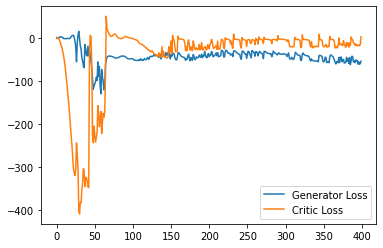

Step 8050: Generator loss: -51.88705871582031, critic loss: -9.834122402191161


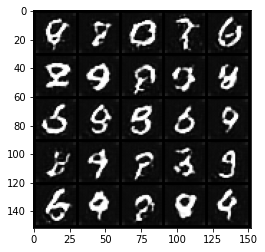

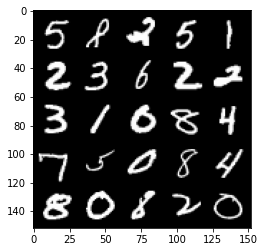

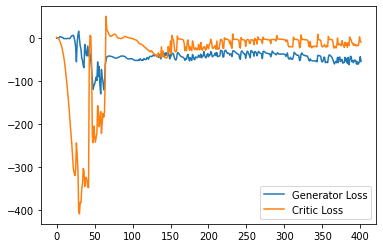

Step 8100: Generator loss: -57.07607154846191, critic loss: -16.481129311561585


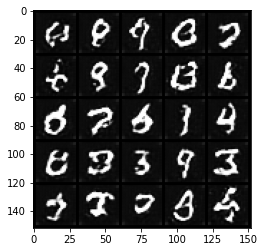

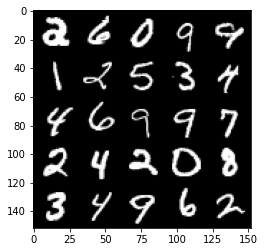

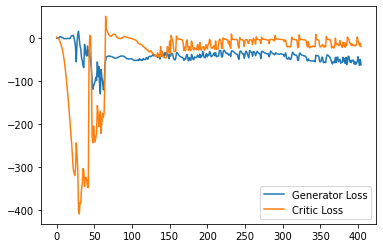

Step 8150: Generator loss: -51.53531448364258, critic loss: -15.352285711050035


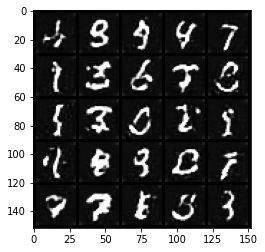

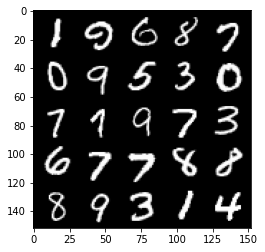

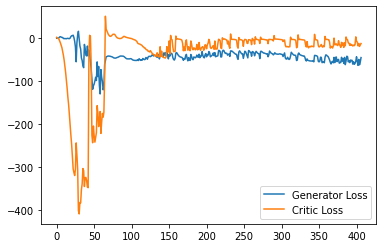

Step 8200: Generator loss: -51.50026062011719, critic loss: -16.207965752601623


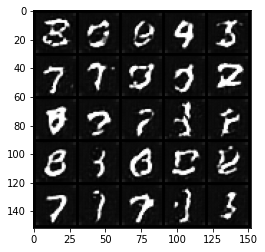

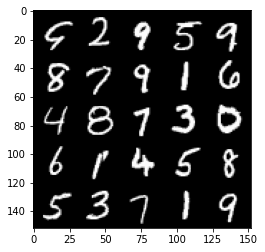

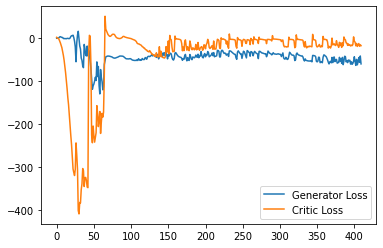

Step 8250: Generator loss: -53.40339267730713, critic loss: -15.747363523960114


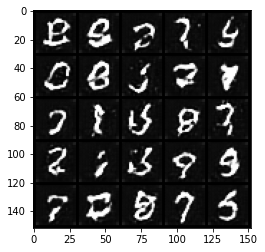

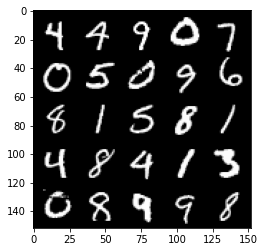

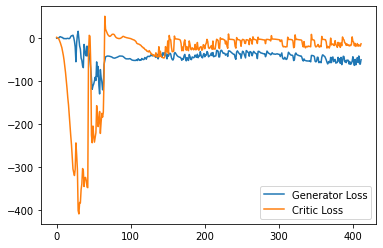

Step 8300: Generator loss: -56.98339797973633, critic loss: -17.033368521690367


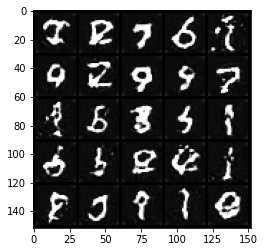

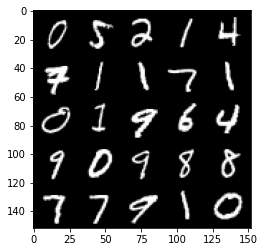

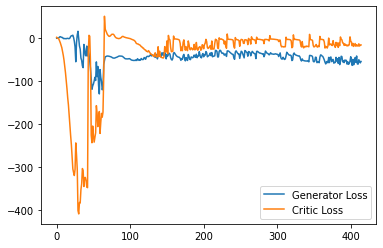

Step 8350: Generator loss: -64.14463684082031, critic loss: -21.265593998670575


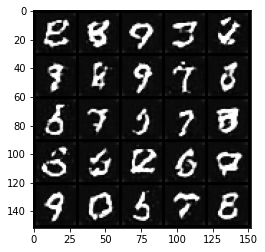

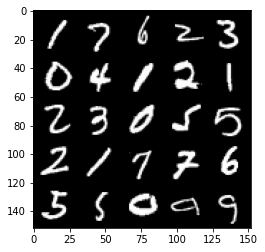

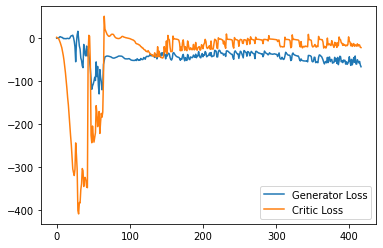

Step 8400: Generator loss: -55.897018127441406, critic loss: -18.88498142886161


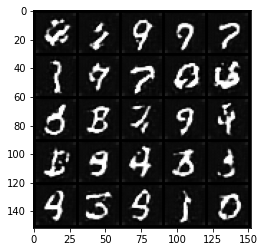

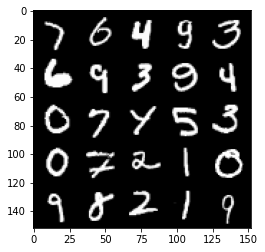

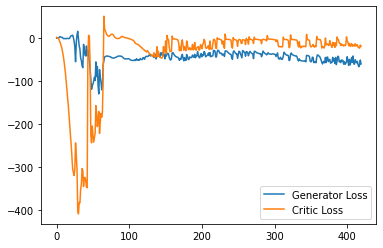

Step 8450: Generator loss: -44.070098037719724, critic loss: 3.595979277133943


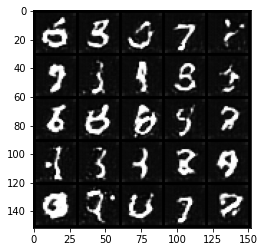

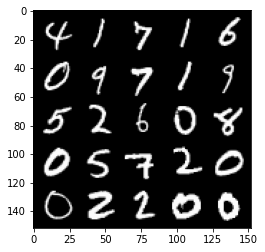

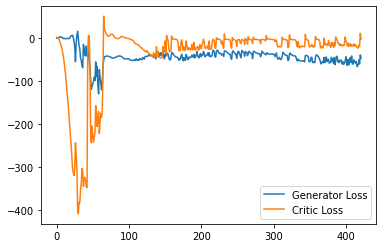

Step 8500: Generator loss: -53.84371620178223, critic loss: -7.230085375308992


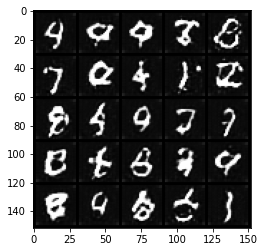

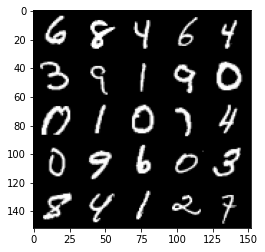

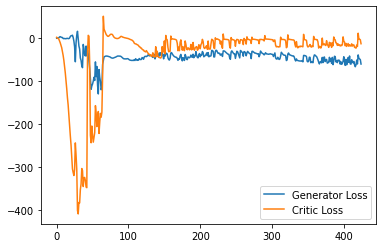

Step 8550: Generator loss: -56.196875762939456, critic loss: -13.967184287548063


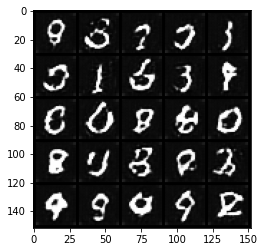

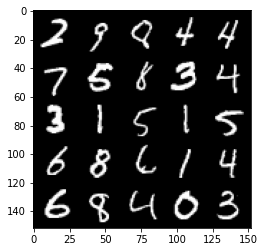

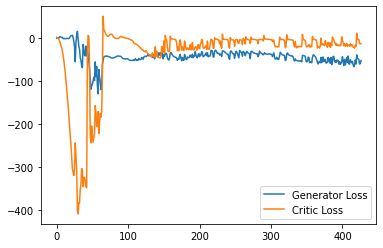

Step 8600: Generator loss: -54.82699478149414, critic loss: -15.121950317382812


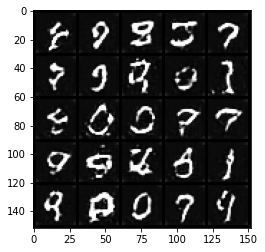

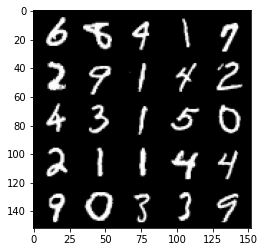

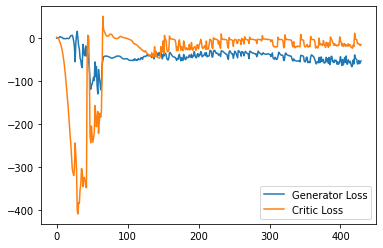

Step 8650: Generator loss: -59.550342102050784, critic loss: -15.244277780056


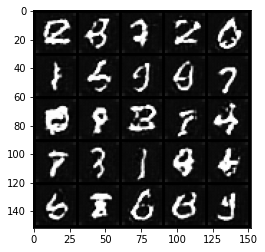

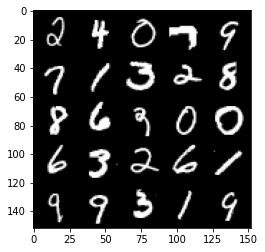

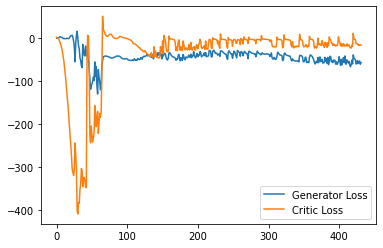

Step 8700: Generator loss: -56.92684318542481, critic loss: -15.712740430355073


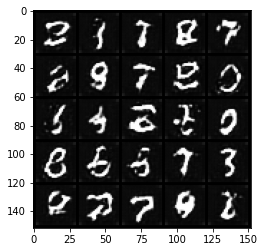

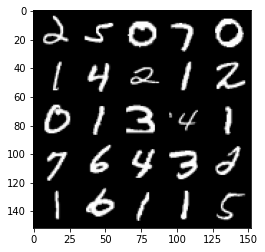

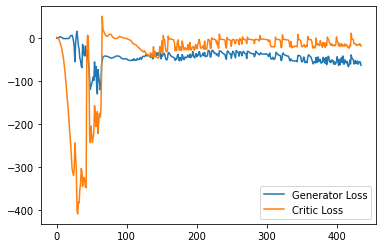

Step 8750: Generator loss: -48.277402038574216, critic loss: -0.6915384378433231


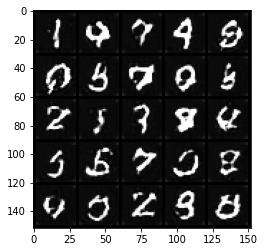

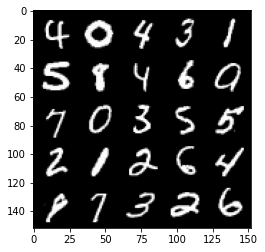

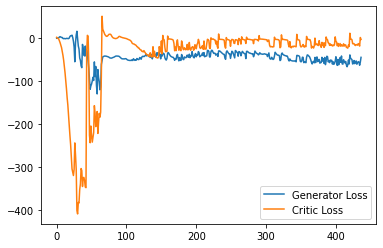

Step 8800: Generator loss: -46.08677452087402, critic loss: -3.628052586555481


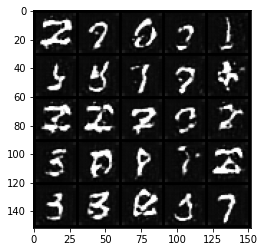

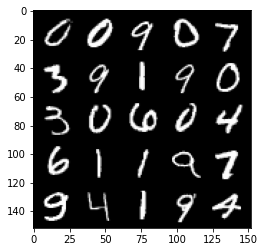

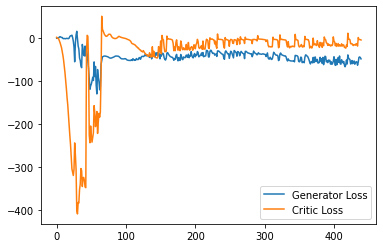

Step 8850: Generator loss: -56.00252235412598, critic loss: -14.810325065612794


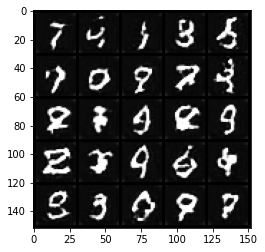

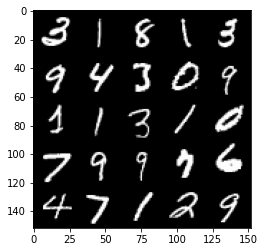

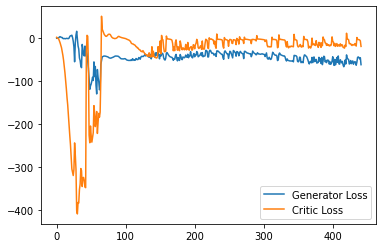

Step 8900: Generator loss: -44.43145380020142, critic loss: 0.8112982826232912


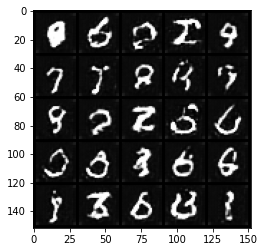

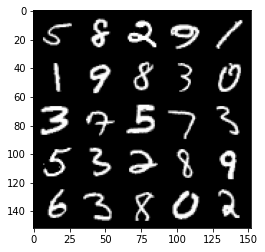

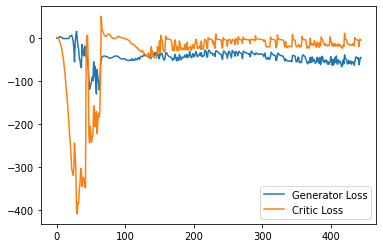

Step 8950: Generator loss: -51.277082748413086, critic loss: -13.412591380119322


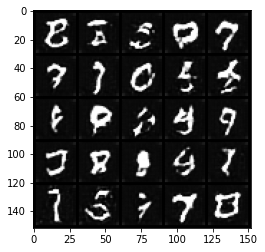

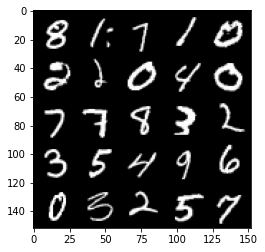

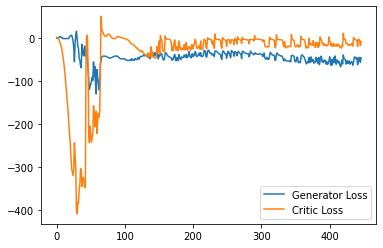

Step 9000: Generator loss: -56.03080696105957, critic loss: -14.775990756988527


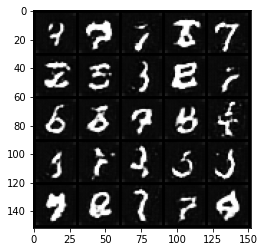

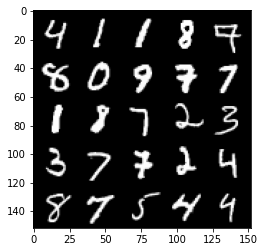

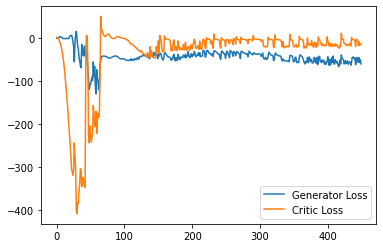

Step 9050: Generator loss: -55.288940620422366, critic loss: -15.088584372997285


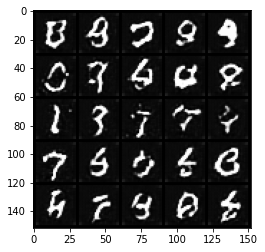

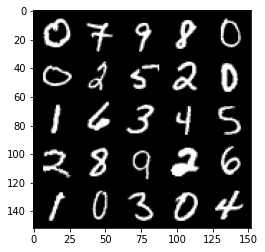

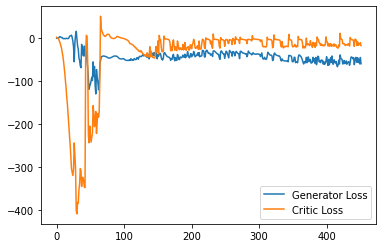

Step 9100: Generator loss: -51.9251309967041, critic loss: -13.748785715103146


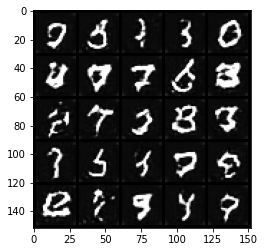

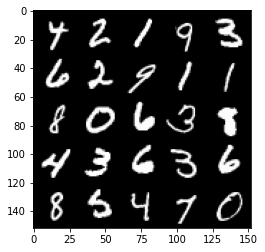

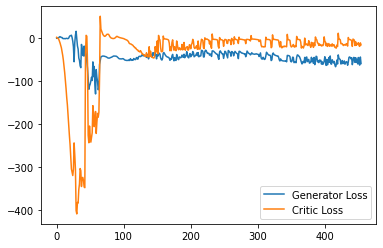

Step 9150: Generator loss: -52.374665145874026, critic loss: -12.644727929830548


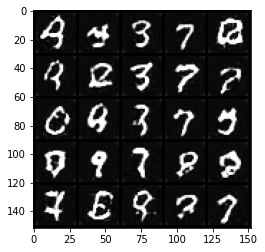

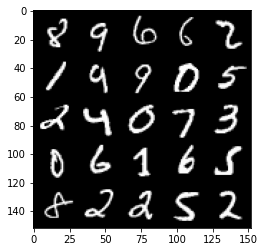

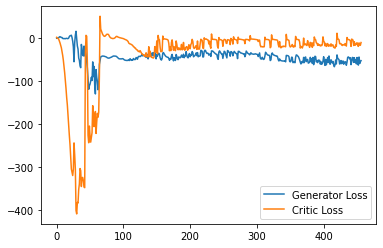

Step 9200: Generator loss: -55.049489974975586, critic loss: -14.908146897792815


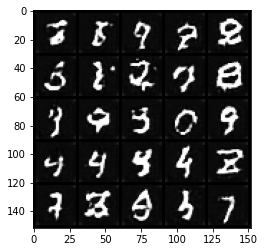

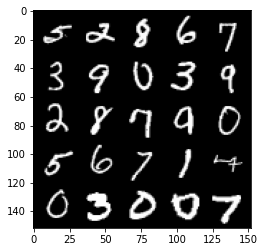

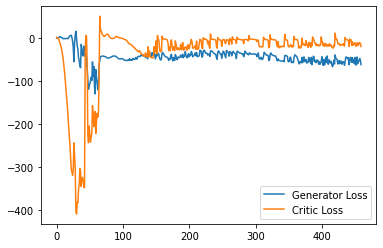

Step 9250: Generator loss: -51.30594512939453, critic loss: -15.193120174884795


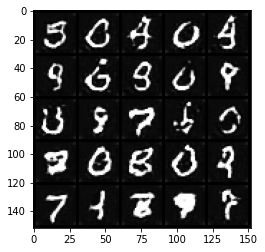

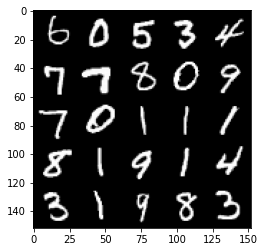

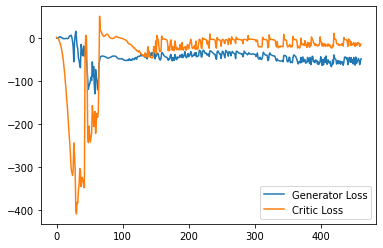

Step 9300: Generator loss: -52.07768367767334, critic loss: -15.227959878683087


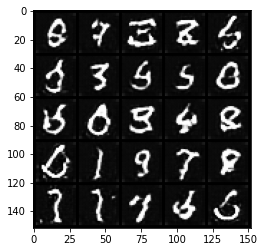

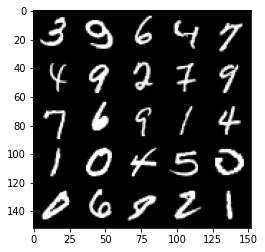

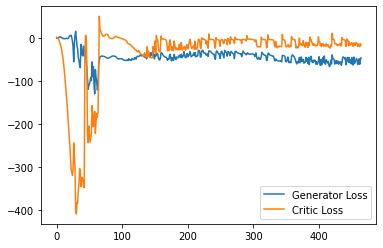

Step 9350: Generator loss: -62.714209671020505, critic loss: -21.038287961721416


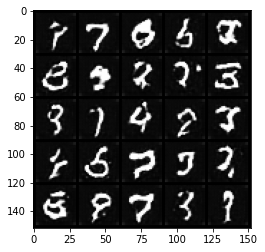

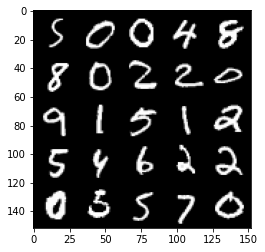

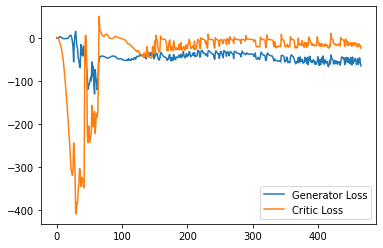

Step 9400: Generator loss: -57.30670337677002, critic loss: -19.059950206756593


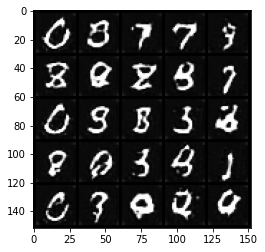

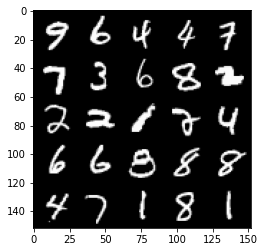

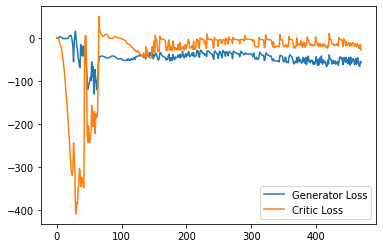

Step 9450: Generator loss: -61.1739533996582, critic loss: -21.069931818127635


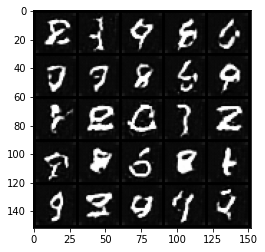

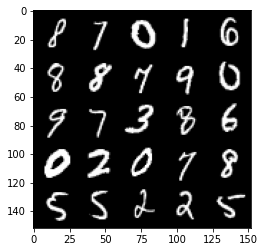

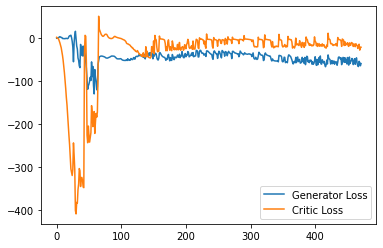

Step 9500: Generator loss: -50.7366718673706, critic loss: -8.261738249063495


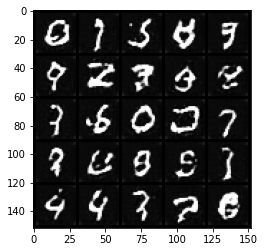

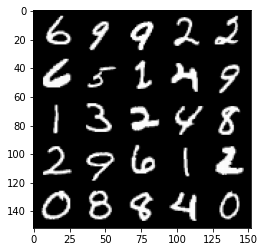

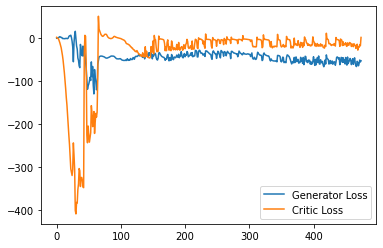

Step 9550: Generator loss: -47.84049102783203, critic loss: -6.337615193367004


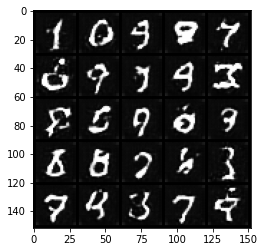

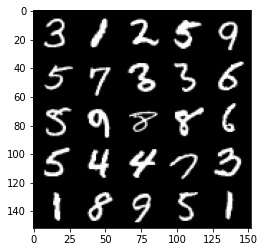

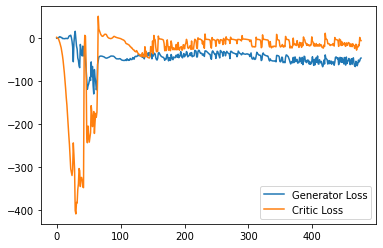

Step 9600: Generator loss: -50.9079846572876, critic loss: -14.7169376282692


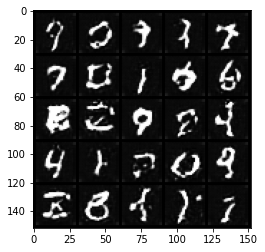

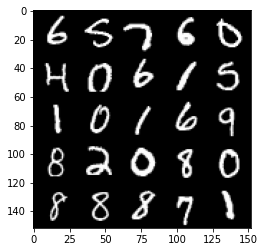

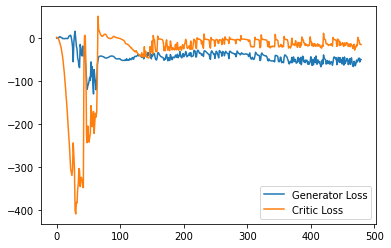

Step 9650: Generator loss: -60.88498092651367, critic loss: -20.350631423234933


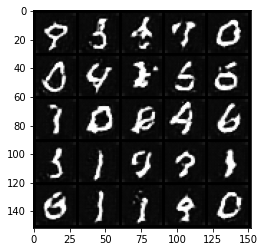

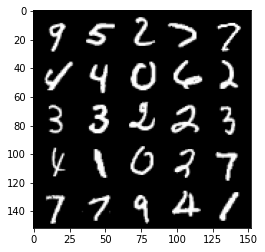

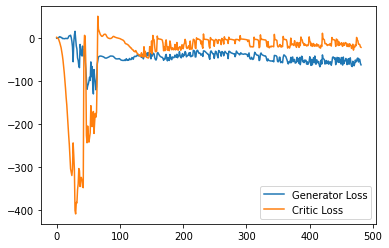

Step 9700: Generator loss: -52.58038777351379, critic loss: -9.8139132938385


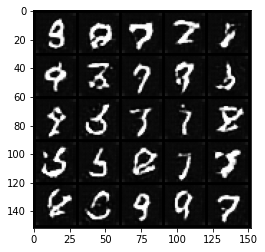

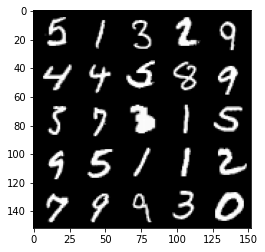

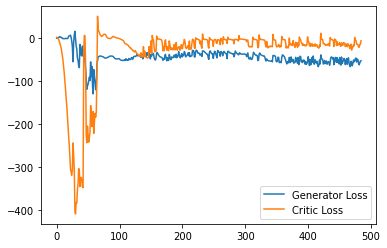

Step 9750: Generator loss: -58.80801998138428, critic loss: -17.89904083561897


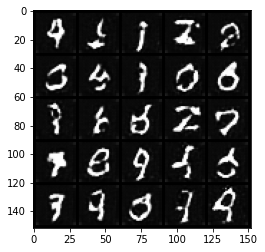

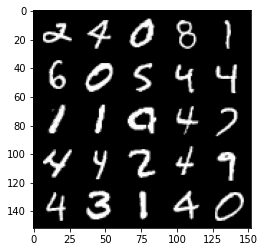

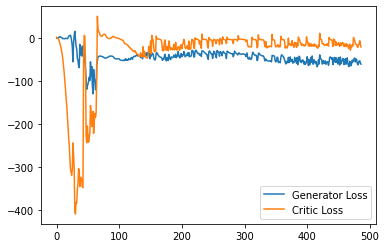

Step 9800: Generator loss: -56.205389976501465, critic loss: -17.21822830915451


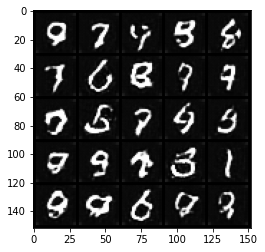

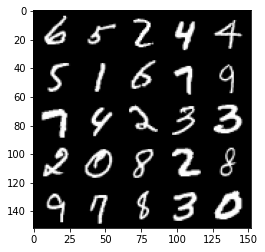

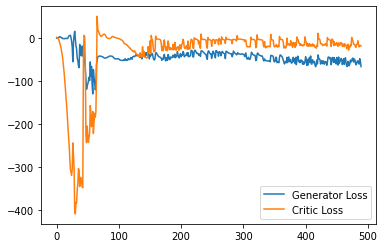

Step 9850: Generator loss: -63.47064056396484, critic loss: -20.439791460156446


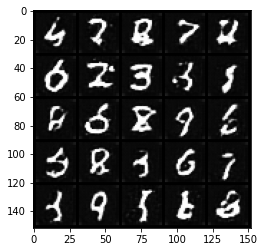

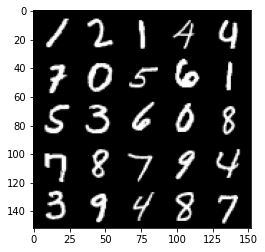

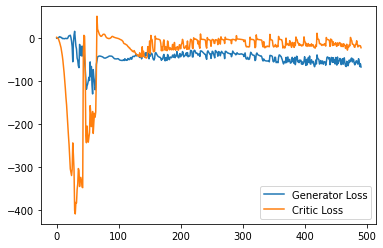

Step 9900: Generator loss: -59.78058647155762, critic loss: -19.08088740825653


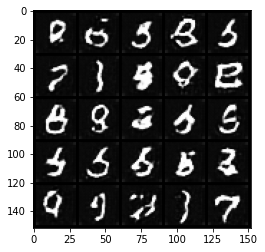

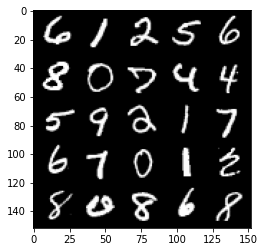

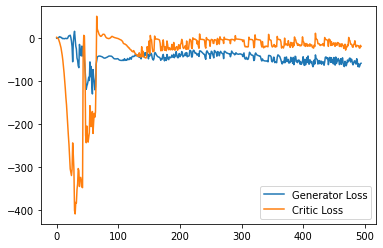

Step 9950: Generator loss: -51.116006240844726, critic loss: -12.498506221771242


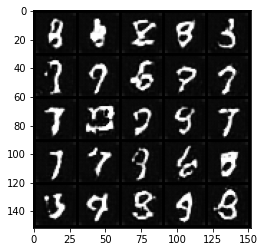

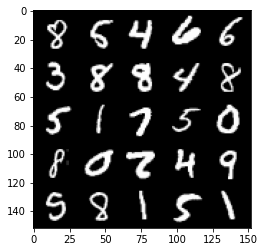

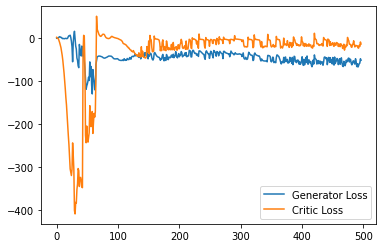

Step 10000: Generator loss: -65.08202308654785, critic loss: -19.492988857746123


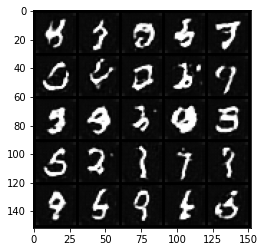

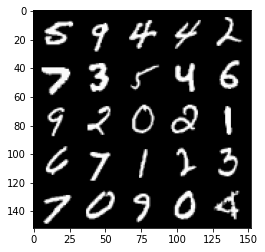

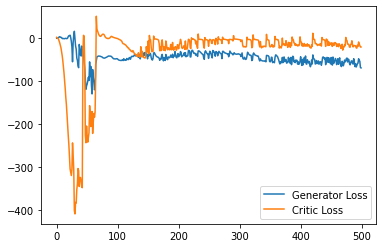

Step 10050: Generator loss: -55.22357250213623, critic loss: -13.929075622558596


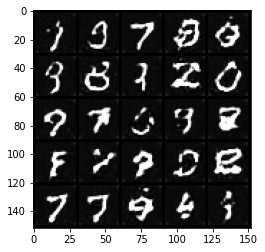

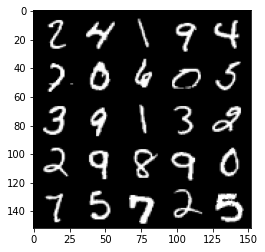

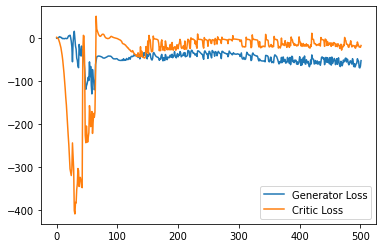

Step 10100: Generator loss: -60.29145248413086, critic loss: -18.768542999505996


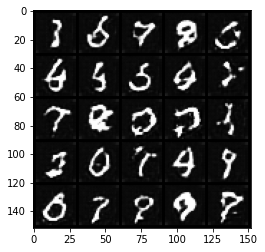

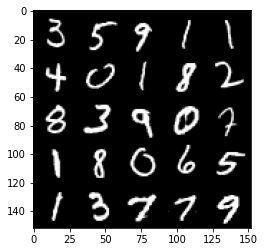

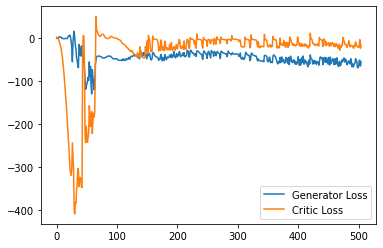

Step 10150: Generator loss: -57.59271774291992, critic loss: -9.811981850624088


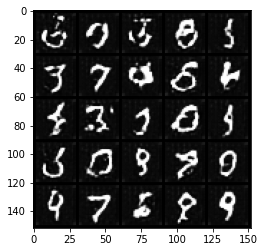

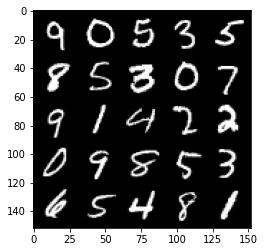

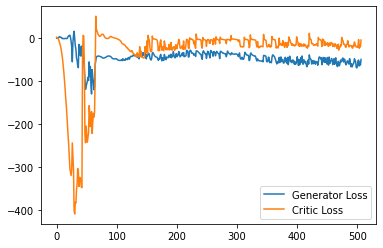

Step 10200: Generator loss: -61.838611068725584, critic loss: -14.424831056594849


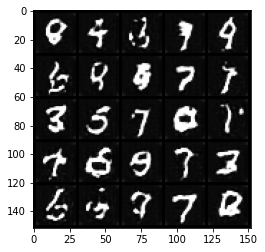

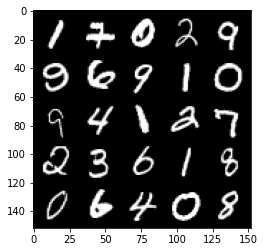

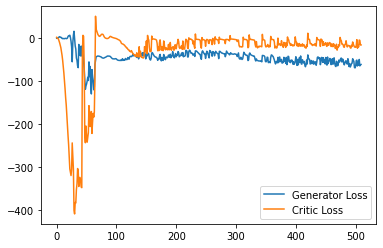

Step 10250: Generator loss: -59.04848487854004, critic loss: -20.20469473528862


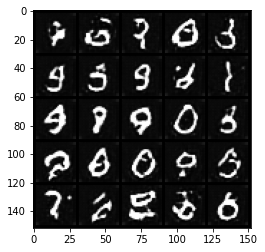

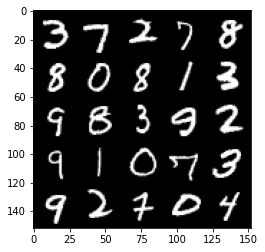

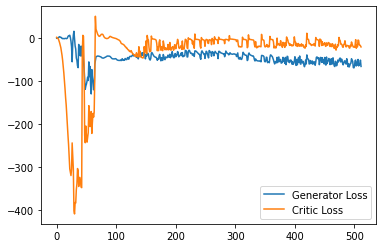

Step 10300: Generator loss: -54.42132694244385, critic loss: -18.374282335162164


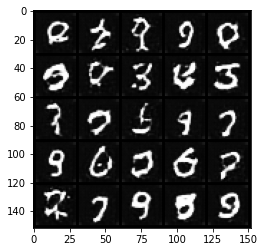

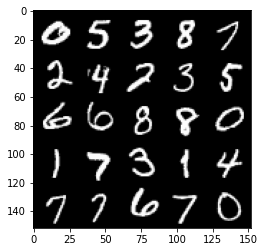

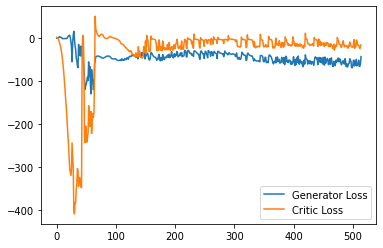

Step 10350: Generator loss: -55.092340545654295, critic loss: -12.168979383945457


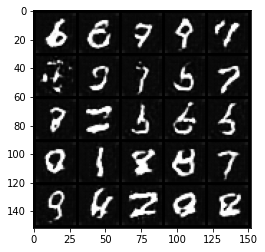

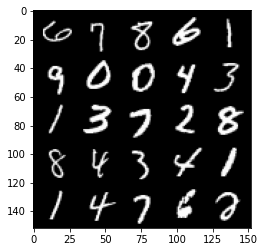

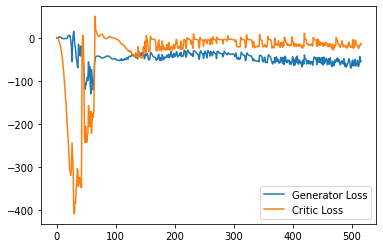

Step 10400: Generator loss: -54.46852428436279, critic loss: -1.302589962005614


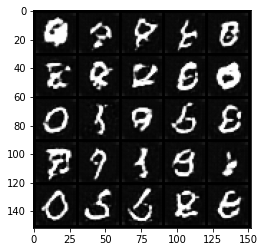

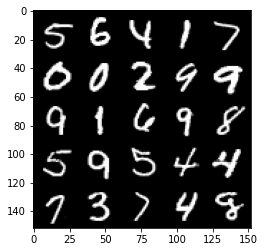

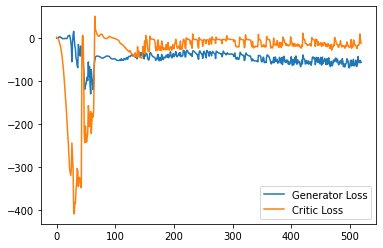

Step 10450: Generator loss: -68.47803497314453, critic loss: -18.244133649826054


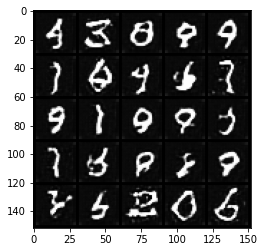

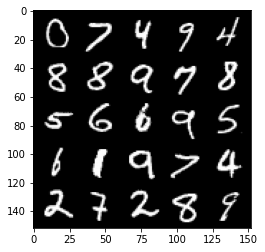

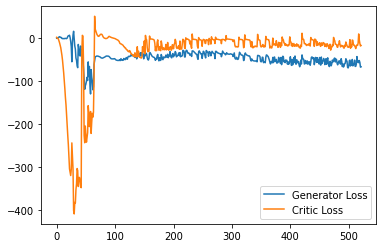

Step 10500: Generator loss: -60.03934425354004, critic loss: -16.42372640132904


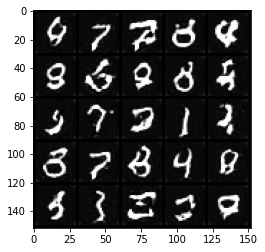

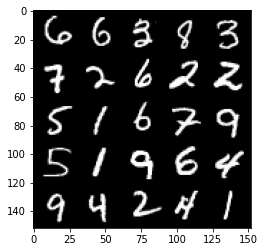

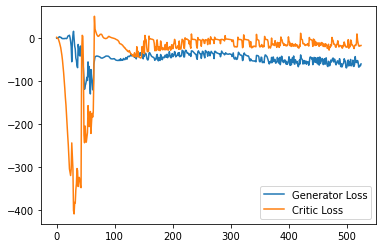

Step 10550: Generator loss: -69.93688186645508, critic loss: -23.135257918357844


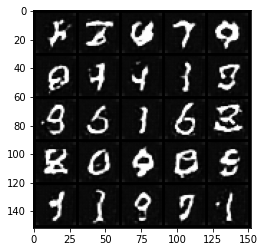

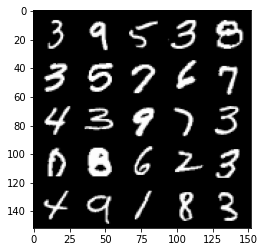

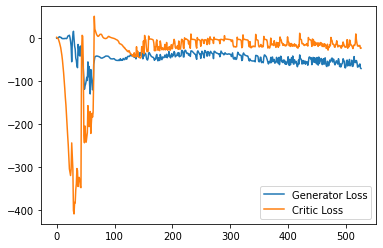

Step 10600: Generator loss: -59.21689308166504, critic loss: -16.259617138385774


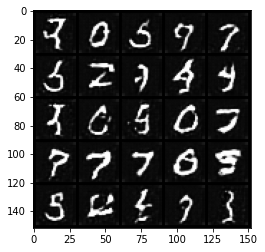

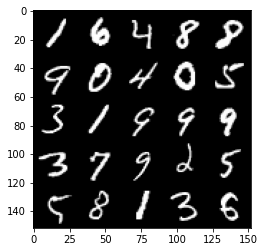

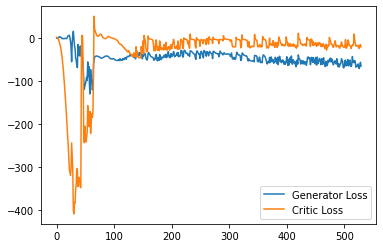

Step 10650: Generator loss: -61.36175926208496, critic loss: -15.795678978681563


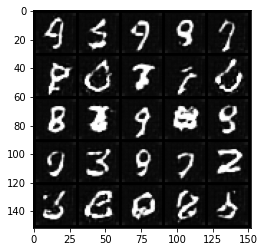

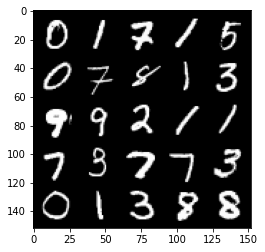

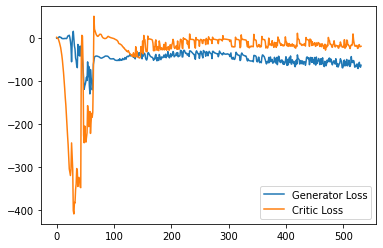

Step 10700: Generator loss: -58.46366554260254, critic loss: -13.41624103021622


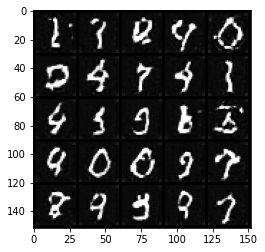

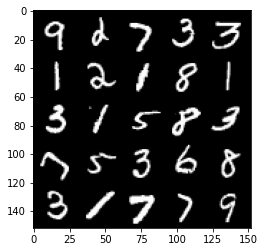

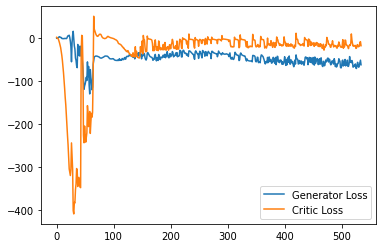

Step 10750: Generator loss: -65.97786163330078, critic loss: -18.07348739624023


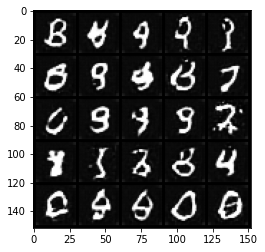

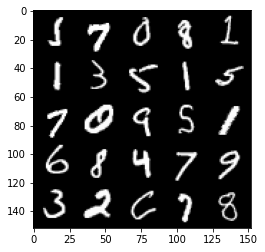

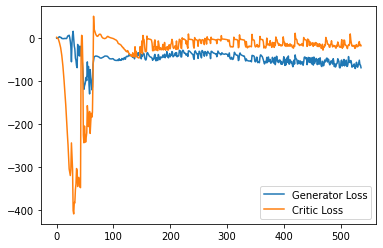

Step 10800: Generator loss: -58.239522552490236, critic loss: -13.58803854417801


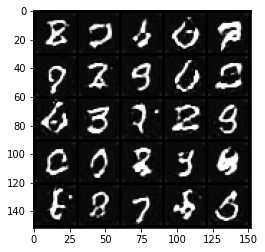

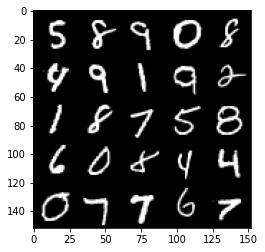

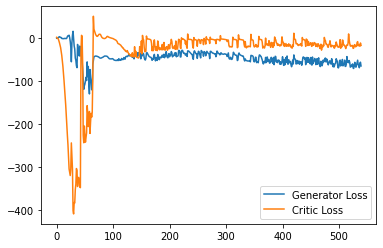

Step 10850: Generator loss: -62.12235904693603, critic loss: -16.501934121608734


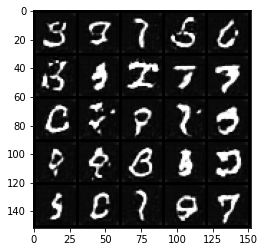

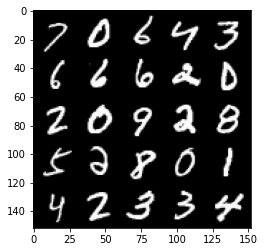

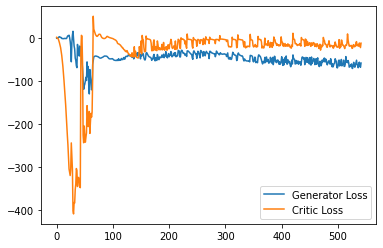

Step 10900: Generator loss: -59.91219223022461, critic loss: -15.03772449350357


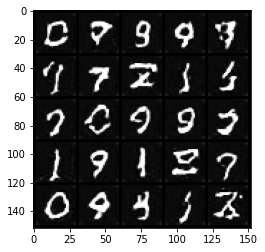

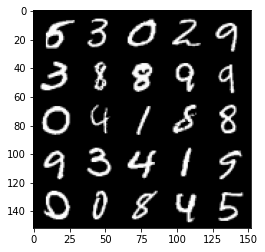

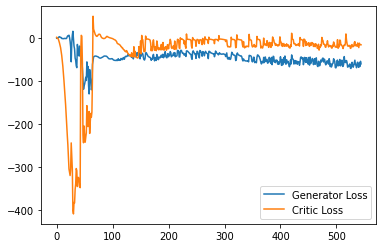

Step 10950: Generator loss: -61.27477020263672, critic loss: -13.667249264478684


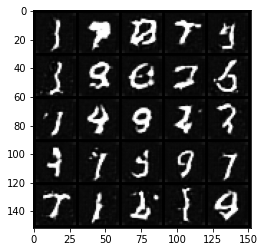

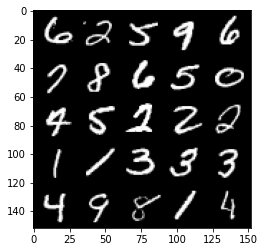

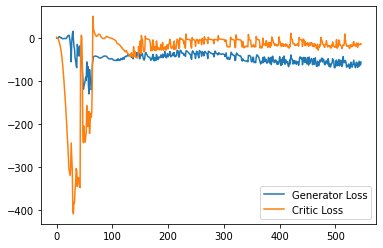

Step 11000: Generator loss: -64.5089331817627, critic loss: -18.506859283208847


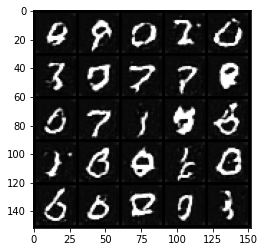

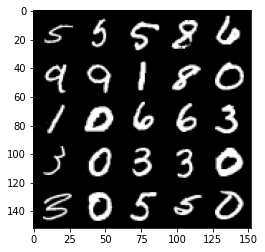

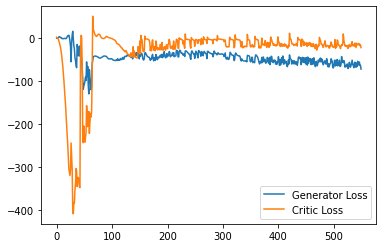

Step 11050: Generator loss: -65.11950668334961, critic loss: -19.132623721241952


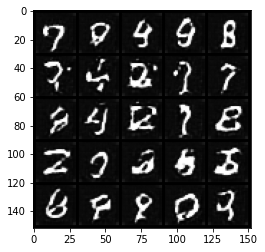

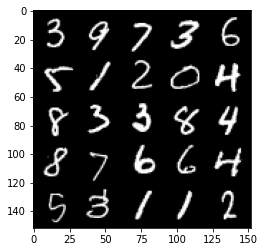

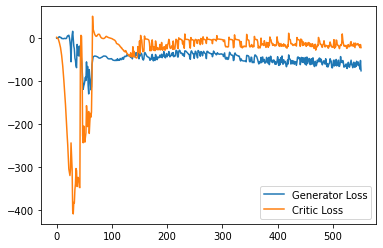

Step 11100: Generator loss: -60.47459209442139, critic loss: -15.466039387702942


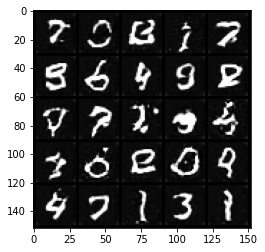

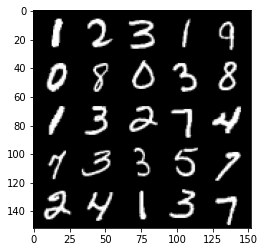

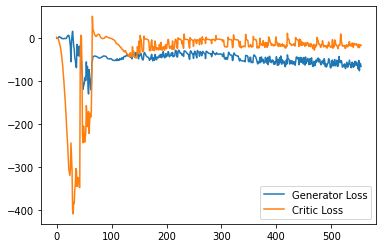

Step 11150: Generator loss: -61.95481430053711, critic loss: -15.984726402282716


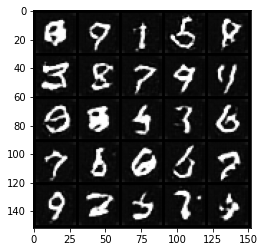

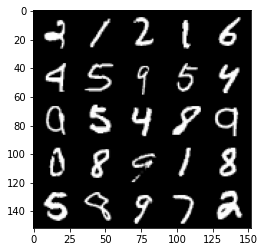

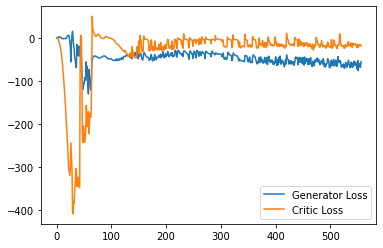

Step 11200: Generator loss: -61.85911560058594, critic loss: -4.280949553489686


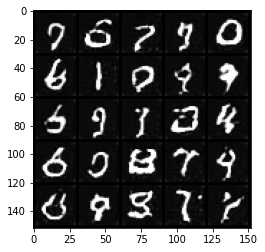

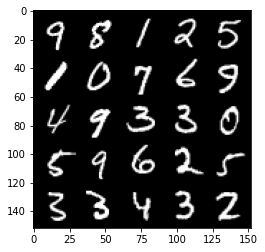

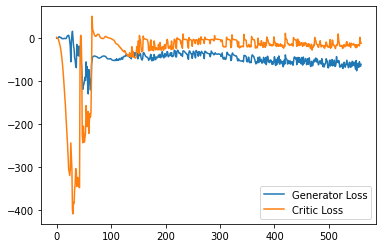

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
